# Mar ??, 2022 ()

**Motivation**:  <br>

In [1]:
# HIDE CODE


import os
import sys
import nibabel as nib
import networkx as nx
from time import time
from pprint import pprint
from copy import deepcopy as dc
from os.path import join as pjoin
from numpy.ma import masked_where as mwh
from scipy.ndimage import gaussian_filter
from IPython.display import display, IFrame, HTML
from matplotlib.colors import rgb2hex, to_rgb
import matplotlib.pyplot as plt
import seaborn as sns

# set style & no interpolalation
import matplotlib
matplotlib.rcParams['image.interpolation'] = 'none'
sns.set_style('whitegrid')
%matplotlib inline

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
tmp_dir = pjoin(git_dir, 'jb-Ca-fMRI/tmp')
extras_dir = pjoin(git_dir, 'jb-Ca-fMRI/_extras')
lfr_dir = pjoin(os.environ['HOME'], 'Documents/workspaces/lfr/binary_overlapping')


# GitHub
sys.path.insert(0, pjoin(git_dir, '_Ca-fMRI'))
from register.atlas import make_tree_graph
from register.parcellation import Parcellation
from analysis.hierarchical import Hierarchical
from analysis.fourier import *
from analysis.bootstrap import *
from analysis.svinet import *
from analysis.group import *
from analysis.lfr import *
from utils.render import *
from utils.plotting import *
from model.mouse import Mice
from model.configuration import Config

# warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [2]:
# HIDE CODE


def plot_cartography(
    df: pd.DataFrame,
    palette: Dict[str, str],
    xlim: Tuple[float, float] = None,
    ylim: Tuple[float, float] = None,
    hue: str = 'oc_idx',
    grid: bool = True,
    display: bool = True,
    leg_size: float = 14,
    size: float = 7,
    scatter_kws: dict = None,
    density_kws: dict = None,
    median_kws: dict = None, ):
    
    scatter_kws = scatter_kws if scatter_kws else {
        's': 120,
        'alpha': 0.9,
        'edgecolor': 'dimgrey',
    }
    density_kws = density_kws if density_kws else {
        'lw': 2,
        'fill': True,
        'alpha': 0.5,
    }
    median_kws = median_kws if median_kws else {
        'lw': 2,
        'ls': '--',
        'zorder': 0,
        'alpha': 1.0,
        'c': sns.color_palette('deep')[7],
    }
    
    set_style('ticks')
    jg = sns.JointGrid(
        data=df,
        x='entropy',
        y='degree',
        hue=hue,
        size=size,
        palette=palette,
        xlim=xlim,
        ylim=ylim,
        space=0.0,
    )
    # joint: scatter
    jg.plot_joint(
        sns.scatterplot,
        hue=hue,
        **scatter_kws,
    )
    # margnials: density
    jg.plot_marginals(
        sns.kdeplot,
        **density_kws,
    )
    # medians
    for name in ['entropy', 'degree']:
        x = df[name].median()
        lbl = f"median {name}: {x:.2f}"
        if name == 'entropy':
            jg.ax_joint.axvline(x, label=lbl, **median_kws)
        else:
            jg.ax_joint.axhline(x, label=lbl, **median_kws)
    # legend
    jg.ax_joint.legend(loc='upper left', prop={'size': leg_size})
    leg = leg = jg.ax_joint.get_legend()
    if leg is not None:
        plt.setp(leg, bbox_to_anchor=(1.3, 1.0))
    
    if grid:
        jg.ax_joint.grid()
    
    if display:
        plt.show()
    else:
        plt.close()
    return jg


def plot_swarm(
        df: pd.DataFrame,
        palette: dict,
        variable: str = 'entropy',
        display: bool = True,
        **kwargs, ):
    defaults = {
        'sensory_idxs': [2, 3],
        'kind': 'swarm',
        'aspect': 1.2,
        's': 12,
        'x_fontsize': 15,
        'title_fontsize': 15,
        'xtick_labelsize': 13,
        'ytick_labelsize': 14,
    }
    for k, v in defaults.items():
        if k not in kwargs:
            kwargs[k] = v

    median = df[variable].median()
    sns.set_theme(style='ticks')
    fg = sns.catplot(
        x=variable,
        y='tag',
        data=df,
        hue='oc_idx',
        col='oc_type',
        order=sorted(df['tag'].unique()),
        palette=palette,
        kind=kwargs['kind'],
        aspect=kwargs['aspect'],
        s=kwargs['s'],
    )
    for ax in fg.axes.ravel():
        ax.axvline(
            x=median,
            ls='--',
            lw=2,
            alpha=1.0,
            c=sns.color_palette('deep')[7],
            label=f"median {variable}: {median:.2f}",
            zorder=0,
        )
        ax.tick_params('x', labelsize=kwargs['xtick_labelsize'])
        ax.tick_params('y', labelsize=kwargs['ytick_labelsize'])
        ax.title.set_fontsize(kwargs['title_fontsize'])
        ax.set_xlabel(variable, fontsize=kwargs['x_fontsize'])
        ax.set_ylabel('')
        ax.grid(axis='y')

    if display:
        plt.show()
    else:
        plt.close()
    return fg

## Fig dir

In [3]:
fig_dir = pjoin(tmp_dir, 'fig_25th')
os.makedirs(fig_dir, exist_ok=True)

## Prepare

In [4]:
mice = Mice(128)
mice.setup_func_data('rest')

mako = sns.color_palette('mako', as_cmap=True)
rocket = sns.color_palette('rocket', as_cmap=True)
pal = {'ca2': mako(0.6), 'bold-lite': rocket(0.6)}

num_k, perc = 5, 10
props_base = {
    'perc': f'p{perc}-sample',
    'num_k': num_k,
    'mice': mice,
    'task': 'rest',
    'metric': 'pearson',
    'match_using': 'gam',
    'match_metric': 'euclidean',
    'graph_type': 'real',
    'verbose': False,
}
props_ca = {'mode': 'ca2', **props_base}
props_bold = {'mode': 'bold-lite', **props_base}

In [5]:
gr_ca = Group(**props_ca).fit_group()
gr_bold = Group(**props_bold).fit_group()

sim = dist2sim(sp_dist.cdist(
    XA=gr_bold.grp_pi,
    XB=gr_ca.grp_pi,
    metric='cosine',
))
mapping = find_best_match(sim)
ids = list(mapping.values())

gr_bold.pi = gr_bold.grp_pi
gr_ca.pi = gr_ca.grp_pi[ids]

proj_bold = gr_bold.project_vec()
proj_ca = gr_ca.project_vec()

ids

[0, 1, 2, 3, 4]

In [6]:
from numpy.ma import masked_where as mwh
from scipy.ndimage import gaussian_filter

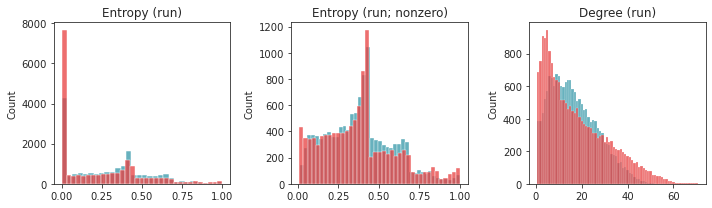

In [7]:
fig, axes = create_figure(1, 3, (10, 3))
sns.histplot(gr_ca.run_h[np.isfinite(gr_ca.run_h)], color=pal['ca2'], ax=axes[0])
sns.histplot(gr_bold.run_h[np.isfinite(gr_bold.run_h)], color=pal['bold-lite'], ax=axes[0])
axes[0].set_title('Entropy (run)')

sns.histplot(gr_ca.run_h[gr_ca.run_h.nonzero()], color=pal['ca2'], ax=axes[1])
sns.histplot(gr_bold.run_h[gr_bold.run_h.nonzero()], color=pal['bold-lite'], ax=axes[1])
axes[1].set_title('Entropy (run; nonzero)')

sns.histplot(gr_ca.run_deg[np.isfinite(gr_ca.run_deg)],
             bins=np.linspace(0.5, 70.5, 71), color=pal['ca2'], ax=axes[2])
sns.histplot(gr_bold.run_deg[np.isfinite(gr_bold.run_deg)],
             bins=np.linspace(0.5, 70.5, 71), color=pal['bold-lite'], ax=axes[2])
axes[2].set_title('Degree (run)')

plt.show()

In [8]:
len(gr_ca.run_h.flat), len(gr_ca.run_deg.flat)

(20880, 20880)

In [9]:
len(gr_bold.run_h.flat), len(gr_bold.run_deg.flat)

(20880, 20880)

In [10]:
num = len(gr_ca.run_h.flat)

In [11]:
df = pd.DataFrame({
    'mode': ['ca2'] * num + ['bold-lite'] * num,
    'Degree': list(gr_ca.run_deg.flat) + list(gr_bold.run_deg.flat),
    'Entropy': list(gr_ca.run_h.flat) + list(gr_bold.run_h.flat),
})

In [12]:
df

,mode,Degree,Entropy
0,ca2,NaN,NaN
1,ca2,NaN,NaN
2,ca2,NaN,NaN
3,ca2,NaN,NaN
4,ca2,NaN,NaN
...,...,...,...
41755,bold-lite,8.0,0.000000
41756,bold-lite,25.0,0.000000
41757,bold-lite,5.0,0.000000
41758,bold-lite,4.0,0.242585


In [13]:
41760 / num

2.0

<AxesSubplot:xlabel='Entropy', ylabel='Degree'>

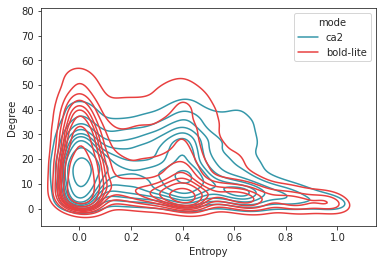

In [14]:
sns.kdeplot(
    data=df,
    x='Entropy',
    y='Degree',
    hue='mode',
    palette=pal,
)

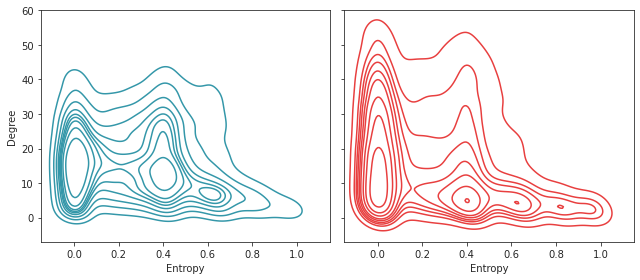

In [15]:
ylim_max = 60

fig, axes = create_figure(1, 2, (9, 4), 'all', 'all')
for ax, (mode, c) in zip(axes.flat, pal.items()): 
    sns.kdeplot(
        data=df.loc[df['mode'] == mode],
        x='Entropy',
        y='Degree',
        color=c,
        ax=ax,
    )
ylim = ax.get_ylim()
ax.set_ylim((ylim[0], ylim_max))
plt.show()

### Full df

In [16]:
affil, affil_included = gr_ca.node_affiliations()

In [23]:
dlist = []
looper = itertools.product(range(10), range(3), range(4))
for i, j, k in looper:
    if np.isnan(gr_ca.run_h[i, j, k]).sum() < len(gr_ca.n2l):
        dlist.append({
            'mode': ['ca2'] * len(affil_included),
            'subject': [i + 1] * len(affil_included),
            'session': [j + 1] * len(affil_included),
            'run': [k + 1] * len(affil_included),
            'Affiliation': affil_included,
            'Entropy': gr_ca.run_h[i, j, k],
            'Degree': gr_ca.run_deg[i, j, k],
        })
    if np.isnan(gr_bold.run_h[i, j, k]).sum() < len(gr_bold.n2l):
        dlist.append({
            'mode': ['bold-lite'] * len(affil_included),
            'subject': [i + 1] * len(affil_included),
            'session': [j + 1] * len(affil_included),
            'run': [k + 1] * len(affil_included),
            'Affiliation': affil_included,
            'Entropy': gr_bold.run_h[i, j, k],
            'Degree': gr_bold.run_deg[i, j, k],
        })
df = pd.DataFrame(merge_dicts(dlist))
df.shape

(40368, 7)

In [35]:
sp_stats.entropy([0.15, 0.85, 0, 0, 0]) / np.log(5), sp_stats.entropy([0.2, 0.8, 0, 0, 0]) / np.log(5)

(0.26264392340968856, 0.31091750708257115)

In [45]:
vlines = [0.25, 0.52]
hlines = [15]

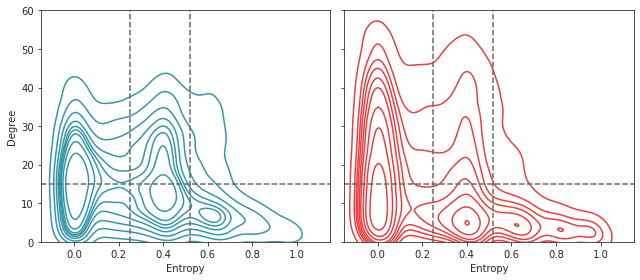

In [46]:
fig, axes = create_figure(1, 2, (9, 4), 'all', 'all')
for ax, (mode, c) in zip(axes.flat, pal.items()):
    for x in vlines:
        ax.axvline(x, color='dimgrey', ls='--')
    for y in hlines:
        ax.axhline(y, color='dimgrey', ls='--')
    sns.kdeplot(
        data=df.loc[df['mode'] == mode],
        x='Entropy',
        y='Degree',
        color=c,
        ax=ax,
    )
ax.set_ylim((0, 60))

plt.show()

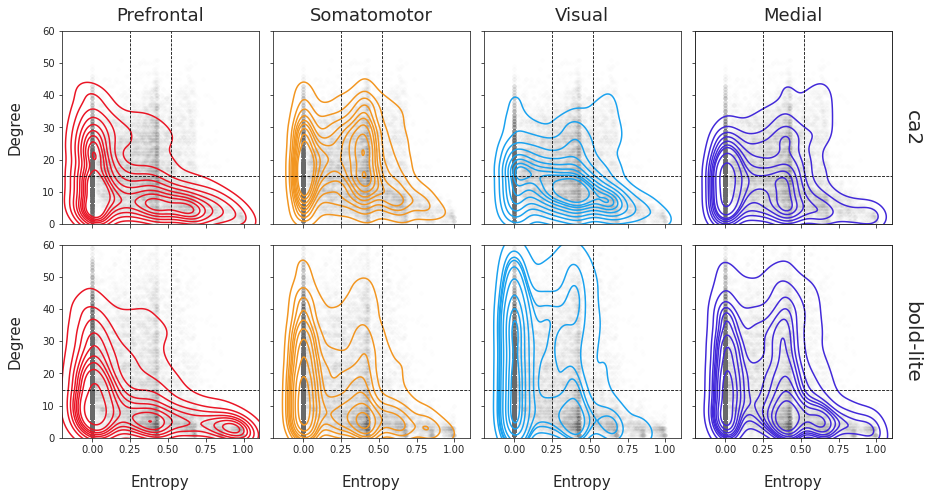

In [47]:
selected = ['Prefrontal', 'Somatomotor', 'Visual', 'Medial']

fig, axes = create_figure(2, len(selected), (13, 7), 'all', 'all')

for ax in axes.flat:
    for x in vlines:
        ax.axvline(x, color='k', ls='--', lw=0.8)
    for y in hlines:
        ax.axhline(y, color='k', ls='--', lw=0.8)

for i, af in enumerate(selected):
    for ax, (mode, c) in zip(axes[:, i].flat, pal.items()):
        _df = df.loc[
            (df['mode'] == mode) &
            (df['Affiliation'] == af)
        ]
        sns.scatterplot(
            data=df.loc[df['mode'] == mode],
            x='Entropy',
            y='Degree',
            color='dimgrey',
            s=20,
            alpha=0.01,
            ax=ax,
        )
        sns.kdeplot(
            data=_df,
            x='Entropy',
            y='Degree',
            color=affil['colors'][af],
            ax=ax,
        )
        if mode == 'ca2':
            ax.set_title(af, fontsize=18, y=1.02)
        else:
            ax.set_xlabel('Entropy', fontsize=15, labelpad=20)
        if i == len(selected) - 1:
            axtw = ax.twinx()
            axtw.set_ylabel(mode, fontsize=20, labelpad=30, rotation=-90)
            axtw.set_yticks([])
        elif i == 0:
            ax.set_ylabel('Degree', fontsize=15, labelpad=20)
ax.set_ylim((0, 60))
ax.set_xlim((-0.2, 1.1))

plt.show()

In [48]:
vedges = [0] + vlines + [1]
hedges = [0] + hlines + [100]

coordinates = {}
for i in range(len(hedges) - 1):
    for j in range(len(vedges) - 1):
        coordinates[f"{i}{j}"] = (
            (hedges[i], hedges[i + 1]),
            (vedges[j], vedges[j + 1]),
        )
coordinates

{
    '00': ((0, 15), (0, 0.25)),
    '01': ((0, 15), (0.25, 0.52)),
    '02': ((0, 15), (0.52, 1)),
    '10': ((15, 100), (0, 0.25)),
    '11': ((15, 100), (0.25, 0.52)),
    '12': ((15, 100), (0.52, 1))
}

In [49]:
carto_map = {}
for k, bounds in coordinates.items():
    (lower_deg, upper_deg), (lower_h, upper_h) = bounds
    cond_h = np.logical_and(lower_h <= gr_ca.run_h, gr_ca.run_h < upper_h)
    cond_deg = np.logical_and(lower_deg <= gr_ca.run_deg, gr_ca.run_deg < upper_deg)
    cond = np.logical_and(cond_h, cond_deg)
    carto_map[k] = bn.nanmean(bn.nanmean(bn.nanmean(cond, 2), 1), 0)
    
carto_vec = [np.expand_dims(e, axis=0) for e in carto_map.values()]
carto_vec = np.concatenate(carto_vec)
proj = gr_ca.project_vec(carto_vec, add_disjoint=False)
tr = gr_ca.trim2d(proj)

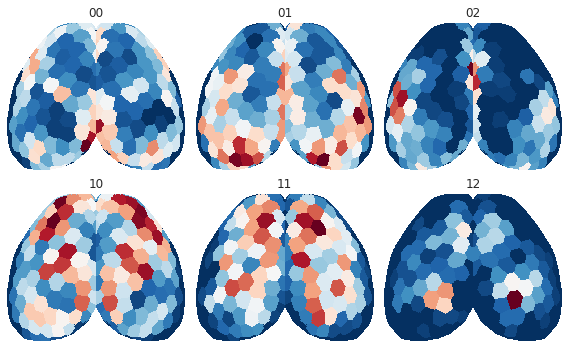

In [50]:
fig, axes = create_figure(2, 3, (8, 5))
for i, k in enumerate(coordinates):
    ax = axes.flat[i]
    x2p = mwh(tr['top'] == 0, tr['proj-top'][i])
    ax.imshow(x2p, cmap='RdBu_r')
    ax.set_title(k)
remove_ticks(axes)

In [51]:
carto_map = {}
for k, bounds in coordinates.items():
    (lower_deg, upper_deg), (lower_h, upper_h) = bounds
    cond_h = np.logical_and(lower_h <= gr_bold.run_h, gr_bold.run_h < upper_h)
    cond_deg = np.logical_and(lower_deg <= gr_bold.run_deg, gr_bold.run_deg < upper_deg)
    cond = np.logical_and(cond_h, cond_deg)
    carto_map[k] = bn.nanmean(bn.nanmean(bn.nanmean(cond, 2), 1), 0)
    
carto_vec = [np.expand_dims(e, axis=0) for e in carto_map.values()]
carto_vec = np.concatenate(carto_vec)
proj = gr_bold.project_vec(carto_vec, add_disjoint=False)
tr = gr_bold.trim2d(proj)

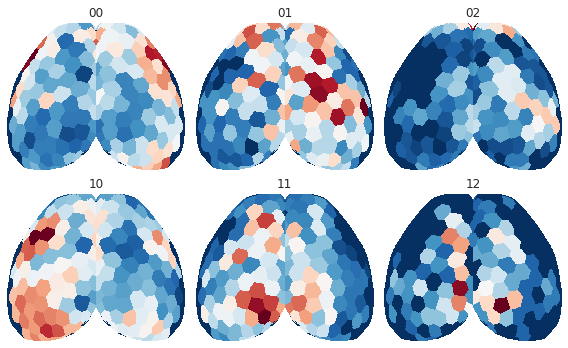

In [52]:
fig, axes = create_figure(2, 3, (8, 5))
for i, k in enumerate(coordinates):
    ax = axes.flat[i]
    x2p = mwh(tr['top'] == 0, tr['proj-top'][i])
    ax.imshow(x2p, cmap='RdBu_r')
    ax.set_title(k)
remove_ticks(axes)

### Animal

In [84]:
gr_ca.anim_deg = bn.nanmean(bn.nanmean(gr_ca.run_deg, 2), 1)
gr_bold.anim_deg = bn.nanmean(bn.nanmean(gr_bold.run_deg, 2), 1)

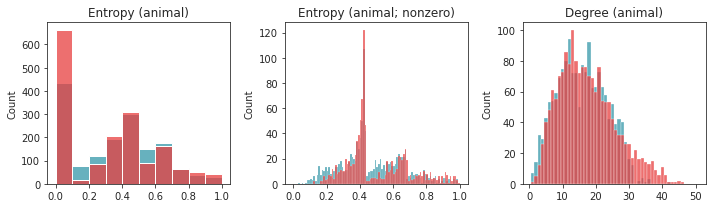

In [85]:
fig, axes = create_figure(1, 3, (10, 3), 'col')
sns.histplot(gr_ca.anim_h[np.isfinite(gr_ca.anim_h)],
             bins=np.linspace(0, 1.0, 11), color=pal['ca2'], ax=axes[0])
sns.histplot(gr_bold.anim_h[np.isfinite(gr_bold.anim_h)],
             bins=np.linspace(0, 1.0, 11), color=pal['bold-lite'], ax=axes[0])
axes[0].set_title('Entropy (animal)')

sns.histplot(gr_ca.anim_h[gr_ca.anim_h.nonzero()],
             bins=np.linspace(0, 1.0, 101), color=pal['ca2'], ax=axes[1])
sns.histplot(gr_bold.anim_h[gr_bold.anim_h.nonzero()],
             bins=np.linspace(0, 1.0, 101), color=pal['bold-lite'], ax=axes[1])
axes[1].set_title('Entropy (animal; nonzero)')

sns.histplot(gr_ca.anim_deg[np.isfinite(gr_ca.anim_deg)],
             bins=np.linspace(0.5, 50.5, 51), color=pal['ca2'], ax=axes[2])
sns.histplot(gr_bold.anim_deg[np.isfinite(gr_bold.anim_deg)],
             bins=np.linspace(0.5, 50.5, 51), color=pal['bold-lite'], ax=axes[2])
axes[2].set_title('Degree (animal)')

plt.show()

In [86]:
x = gr_bold.anim_h[gr_bold.anim_h.nonzero()]
x = x[~np.isnan(x)]
len(x)

1024

In [87]:
bins = np.linspace(0, 1.0, 1001)
bins

array([0.   , 0.001, 0.002, ..., 0.998, 0.999, 1.   ])

In [88]:
hist, bin_edges = np.histogram(x, bins=bins)

In [91]:
max_count = np.max(hist)
max_id = np.where(hist == max_count)[0].item()

max_count, max_id

(46, 430)

In [92]:
bins[max_id], bins[max_id + 1]

(0.43, 0.431)

In [93]:
np.log(2) / np.log(5)

0.43067655807339306

In [94]:
cond = np.logical_and(0.430 < gr_bold.anim_h, gr_bold.anim_h < 0.431)
ids = list(zip(*np.where(cond)))

In [95]:
for i, j in ids:
    print(i, j, np.round(gr_bold.anim_pi_prune[i, :, j], 2))

0 2 [0.52 0.   0.48 0.   0.  ]

0 40 [0.5 0.  0.  0.5 0. ]

0 44 [0.  0.  0.5 0.  0.5]

0 45 [0.   0.   0.48 0.   0.52]

0 51 [0.   0.   0.   0.48 0.52]

0 60 [0.   0.48 0.   0.   0.52]

1 65 [0.  0.5 0.  0.5 0. ]

1 77 [0.   0.52 0.   0.   0.48]

1 96 [0.48 0.   0.52 0.   0.  ]

1 109 [0.51 0.   0.49 0.   0.  ]

2 14 [0.49 0.   0.51 0.   0.  ]

2 144 [0.   0.   0.   0.49 0.51]

2 146 [0.   0.   0.   0.49 0.51]

2 159 [0.   0.48 0.   0.   0.52]

3 27 [0.51 0.   0.49 0.   0.  ]

3 60 [0.  0.5 0.  0.  0.5]

3 98 [0.5 0.  0.5 0.  0. ]

3 121 [0.49 0.   0.   0.51 0.  ]

3 159 [0.   0.52 0.   0.   0.48]

4 20 [0.49 0.   0.51 0.   0.  ]

4 45 [0.   0.   0.49 0.   0.51]

4 54 [0.  0.5 0.  0.  0.5]

4 59 [0.   0.52 0.   0.   0.48]

4 60 [0.   0.48 0.   0.   0.52]

4 76 [0.  0.5 0.  0.  0.5]

4 143 [0.  0.  0.  0.5 0.5]

4 144 [0.  0.5 0.  0.5 0. ]

5 22 [0.   0.   0.52 0.   0.48]

6 20 [0.52 0.   0.48 0.   0.  ]

6 132 [0.  0.  0.  0.5 0.5]

6 134 [0.  0.  0.  0.5 0.5]

6 142 [0.48 0.   0.   0.   0.52]

6 146 [0.  0.5 0.  0.  0.5]

6 147 [0.   0.51 0.   0.   0.49]

6 149 [0.   0.49 0.   0.   0.51]

7 57 [0.   0.48 0.   0.52 0.  ]

7 64 [0.   0.49 0.   0.51 0.  ]

7 96 [0.5 0.  0.5 0.  0. ]

7 136 [0.   0.   0.   0.52 0.48]

7 139 [0.   0.52 0.   0.48 0.  ]

8 47 [0.  0.  0.  0.5 0.5]

8 71 [0.   0.49 0.   0.   0.51]

8 145 [0.   0.51 0.   0.49 0.  ]

8 158 [0.   0.48 0.   0.   0.52]

9 44 [0.   0.   0.49 0.51 0.  ]

9 109 [0.52 0.   0.48 0.   0.  ]

In [96]:
affil, affil_included = gr_ca.node_affiliations()

In [97]:
dlist = []
for i in range(10):
    dlist.append({
        'mode': ['ca2'] * len(affil_included),
        'subject': [i + 1] * len(affil_included),
        'Affiliation': affil_included,
        'Entropy': gr_ca.anim_h[i],
        'Degree': gr_ca.anim_deg[i],
    })
    dlist.append({
        'mode': ['bold-lite'] * len(affil_included),
        'subject': [i + 1] * len(affil_included),
        'Affiliation': affil_included,
        'Entropy': gr_bold.anim_h[i],
        'Degree': gr_bold.anim_deg[i],
    })
df = pd.DataFrame(merge_dicts(dlist))

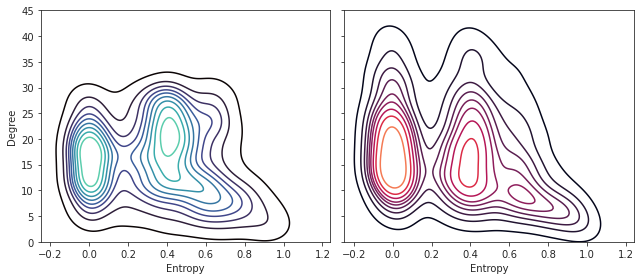

In [98]:
fig, axes = create_figure(1, 2, (9, 4), 'all', 'all')
for ax, (mode, c) in zip(axes.flat, pal.items()): 
    sns.kdeplot(
        data=df.loc[df['mode'] == mode],
        x='Entropy',
        y='Degree',
        cmap='mako' if mode == 'ca2' else 'rocket',
        #color=c,
        ax=ax,
    )
ax.set_ylim((0, 45))
plt.show()

In [163]:
vlines = [0.19, 0.86]
hlines = [16]

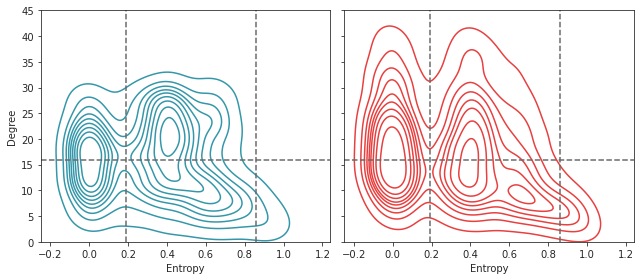

In [164]:
fig, axes = create_figure(1, 2, (9, 4), 'all', 'all')
for ax, (mode, c) in zip(axes.flat, pal.items()):
    for x in vlines:
        ax.axvline(x, color='dimgrey', ls='--')
    for y in hlines:
        ax.axhline(y, color='dimgrey', ls='--')
    sns.kdeplot(
        data=df.loc[df['mode'] == mode],
        x='Entropy',
        y='Degree',
        color=c,
        ax=ax,
    )
ax.set_ylim((0, 45))

plt.show()

In [165]:
selected = ['Prefrontal', 'Somatomotor', 'Visual', 'Medial']

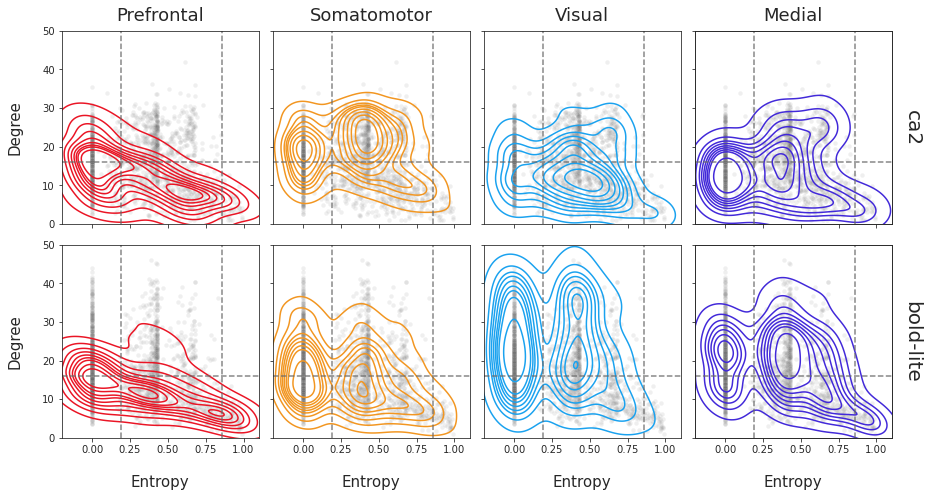

In [166]:
fig, axes = create_figure(2, len(selected), (13, 7), 'all', 'all')

for ax in axes.flat:
    for x in vlines:
        ax.axvline(x, color='dimgrey', ls='--', alpha=0.8)
    for y in hlines:
        ax.axhline(y, color='dimgrey', ls='--', alpha=0.8)

for i, af in enumerate(selected):
    for ax, (mode, c) in zip(axes[:, i].flat, pal.items()):
        _df = df.loc[
            (df['mode'] == mode) &
            (df['Affiliation'] == af)
        ]
        sns.scatterplot(
            data=df.loc[df['mode'] == mode],
            x='Entropy',
            y='Degree',
            color='dimgrey',
            s=20,
            alpha=0.1,
            ax=ax,
        )
        sns.kdeplot(
            data=_df,
            x='Entropy',
            y='Degree',
            color=affil['colors'][af],
            ax=ax,
        )
        if mode == 'ca2':
            ax.set_title(af, fontsize=18, y=1.02)
        else:
            ax.set_xlabel('Entropy', fontsize=15, labelpad=20)
        if i == len(selected) - 1:
            axtw = ax.twinx()
            axtw.set_ylabel(mode, fontsize=20, labelpad=30, rotation=-90)
            axtw.set_yticks([])
        elif i == 0:
            ax.set_ylabel('Degree', fontsize=15, labelpad=20)
ax.set_ylim((0, 50))
ax.set_xlim((-0.2, 1.1))

plt.show()

In [167]:
vedges = [0] + vlines + [1]
hedges = [0] + hlines + [100]

vedges, hedges

([0, 0.19, 0.86, 1], [0, 16, 100])

In [168]:
coordinates = {}
for i in range(len(hedges) - 1):
    for j in range(len(vedges) - 1):
        coordinates[f"{i}{j}"] = (
            (hedges[i], hedges[i + 1]),
            (vedges[j], vedges[j + 1]),
        )
coordinates

{
    '00': ((0, 16), (0, 0.19)),
    '01': ((0, 16), (0.19, 0.86)),
    '02': ((0, 16), (0.86, 1)),
    '10': ((16, 100), (0, 0.19)),
    '11': ((16, 100), (0.19, 0.86)),
    '12': ((16, 100), (0.86, 1))
}

In [169]:
carto_map = {}
for k, bounds in coordinates.items():
    (lower_deg, upper_deg), (lower_h, upper_h) = bounds
    cond_h = np.logical_and(lower_h <= gr_ca.anim_h, gr_ca.anim_h < upper_h)
    cond_deg = np.logical_and(lower_deg <= gr_ca.anim_deg, gr_ca.anim_deg < upper_deg)
    cond = np.logical_and(cond_h, cond_deg)
    carto_map[k] = bn.nanmean(cond, 0)
    
carto_vec = [np.expand_dims(e, axis=0) for e in carto_map.values()]
carto_vec = np.concatenate(carto_vec)
proj = gr_ca.project_vec(carto_vec, add_disjoint=False)
tr = gr_ca.trim2d(proj)

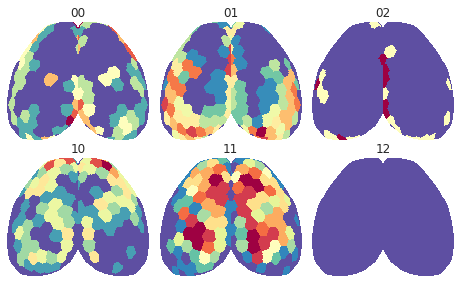

In [173]:
fig, axes = create_figure(2, 3, (6.5, 4))
for i, k in enumerate(coordinates):
    ax = axes.flat[i]
    x2p = mwh(tr['top'] == 0, tr['proj-top'][i])
    ax.imshow(x2p, cmap='Spectral_r')
    ax.set_title(k)
remove_ticks(axes)

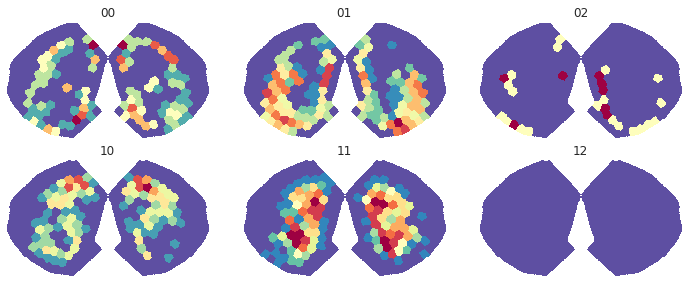

In [174]:
fig, axes = create_figure(2, 3, (10, 4))
for i, k in enumerate(coordinates):
    ax = axes.flat[i]
    x2p = mwh(tr['flat'] == 0, tr['proj-flat'][i])
    ax.imshow(x2p, cmap='Spectral_r')
    ax.set_title(k)
remove_ticks(axes)

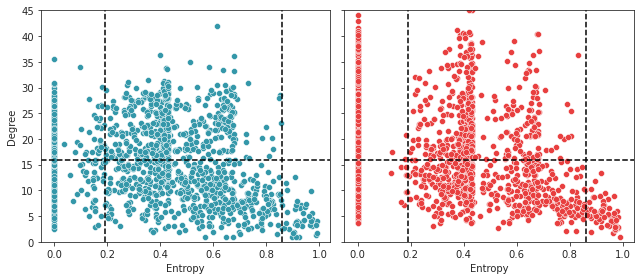

In [175]:
fig, axes = create_figure(1, 2, (9, 4), 'all', 'all')
for ax, (mode, c) in zip(axes.flat, pal.items()):
    for x in vlines:
        ax.axvline(x, color='k', ls='--')
    for y in hlines:
        ax.axhline(y, color='k', ls='--')
    sns.scatterplot(
        data=df.loc[df['mode'] == mode],
        x='Entropy',
        y='Degree',
        color=c,
        ax=ax,
    )
ax.set_ylim((0, 45))

plt.show()

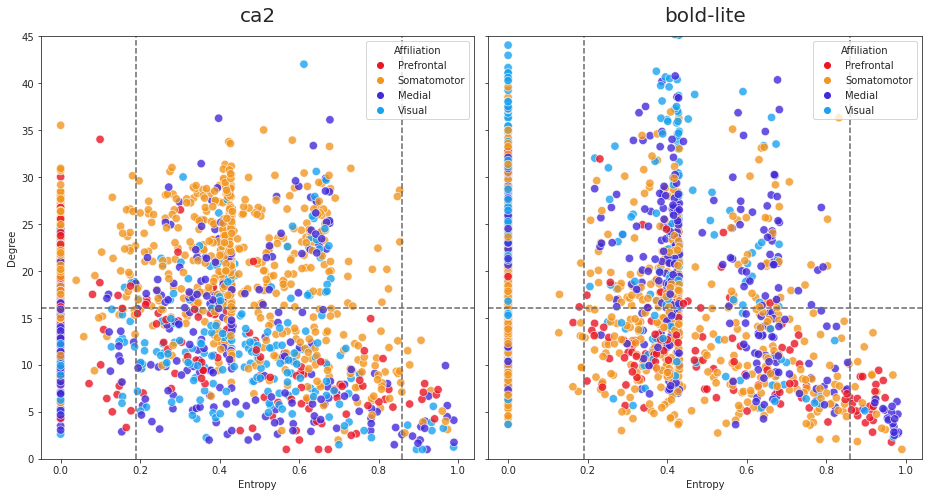

In [176]:
fig, axes = create_figure(1, 2, (13, 7), 'all', 'all')
for ax, (mode, c) in zip(axes.flat, pal.items()):
    for x in vlines:
        ax.axvline(x, color='dimgrey', ls='--')
    for y in hlines:
        ax.axhline(y, color='dimgrey', ls='--')
        
    _df = df.loc[
        (df['mode'] == mode) &
        (~df['Affiliation'].isin(['Auditory', 'Lateral']))
    ]
    sns.scatterplot(
        data=_df,
        x='Entropy',
        y='Degree',
        hue='Affiliation',
        palette=affil['colors'],
        s=70,
        alpha=0.8,
        ax=ax,
    )
    ax.set_title(mode, fontsize=20, y=1.02)
ax.set_ylim((0, 45))

plt.show()

### Group

In [53]:
num = len(gr_ca.grp_h.flat)
gr_ca.grp_deg = bn.nanmean(bn.nanmean(bn.nanmean(gr_ca.run_deg, 2), 1), 0)
gr_bold.grp_deg = bn.nanmean(bn.nanmean(bn.nanmean(gr_bold.run_deg, 2), 1), 0)

In [56]:
df = pd.DataFrame({
    'mode': ['ca2'] * num + ['bold-lite'] * num,
    'Degree': list(gr_ca.grp_deg.flat) + list(gr_bold.grp_deg.flat),
    'Entropy': list(gr_ca.grp_h.flat) + list(gr_bold.grp_h.flat),
    'Affiliation': affil_included * 2,
})

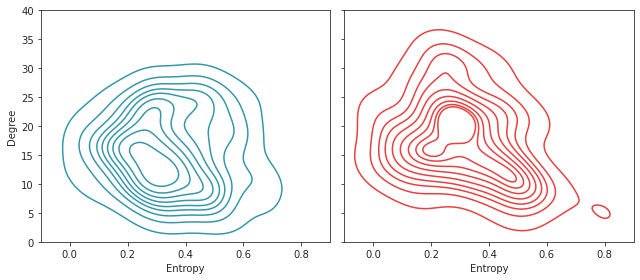

In [57]:
fig, axes = create_figure(1, 2, (9, 4), 'all', 'all')
for ax, (mode, c) in zip(axes.flat, pal.items()): 
    sns.kdeplot(
        data=df.loc[df['mode'] == mode],
        x='Entropy',
        y='Degree',
        # cmap='mako' if mode == 'ca2' else 'rocket',
        color=c,
        ax=ax,
    )
ax.set_ylim((0, 40))
ax.set_xlim((-0.1, 0.9))
plt.show()

In [76]:
vlines = [0.25, 0.43]
hlines = [18]

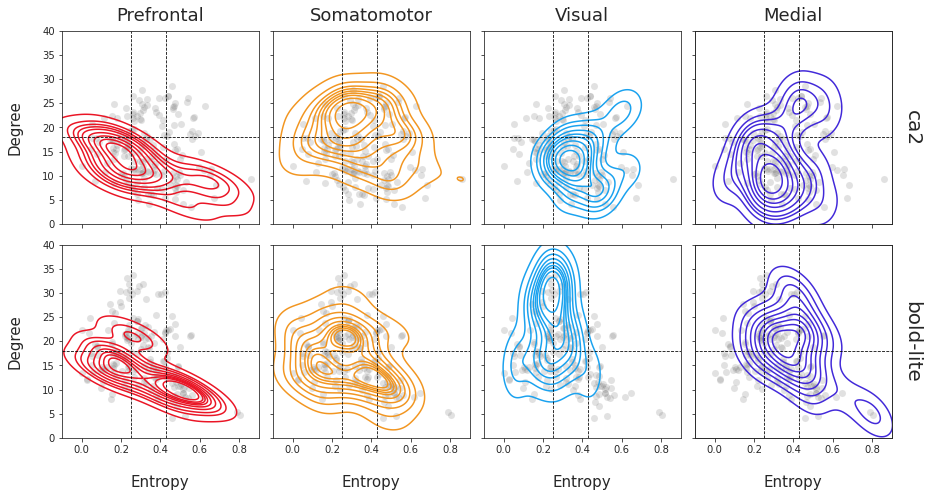

In [77]:
fig, axes = create_figure(2, len(selected), (13, 7), 'all', 'all')

for ax in axes.flat:
    for x in vlines:
        ax.axvline(x, color='k', ls='--', lw=0.8)
    for y in hlines:
        ax.axhline(y, color='k', ls='--', lw=0.8)

for i, af in enumerate(selected):
    for ax, (mode, c) in zip(axes[:, i].flat, pal.items()):
        _df = df.loc[
            (df['mode'] == mode) &
            (df['Affiliation'] == af)
        ]
        sns.scatterplot(
            data=df.loc[df['mode'] == mode],
            x='Entropy',
            y='Degree',
            color='dimgrey',
            s=50,
            alpha=0.2,
            ax=ax,
        )
        sns.kdeplot(
            data=_df,
            x='Entropy',
            y='Degree',
            color=affil['colors'][af],
            ax=ax,
        )
        if mode == 'ca2':
            ax.set_title(af, fontsize=18, y=1.02)
        else:
            ax.set_xlabel('Entropy', fontsize=15, labelpad=20)
        if i == len(selected) - 1:
            axtw = ax.twinx()
            axtw.set_ylabel(mode, fontsize=20, labelpad=30, rotation=-90)
            axtw.set_yticks([])
        elif i == 0:
            ax.set_ylabel('Degree', fontsize=15, labelpad=20)
            # axtw.yaxis.set_label_position("right")
ax.set_ylim((0, 40))
ax.set_xlim((-0.1, 0.9))

plt.show()

In [78]:
vedges = [0] + vlines + [1]
hedges = [0] + hlines + [100]

coordinates = {}
for i in range(len(hedges) - 1):
    for j in range(len(vedges) - 1):
        coordinates[f"{i}{j}"] = (
            (hedges[i], hedges[i + 1]),
            (vedges[j], vedges[j + 1]),
        )
coordinates

{
    '00': ((0, 18), (0, 0.25)),
    '01': ((0, 18), (0.25, 0.43)),
    '02': ((0, 18), (0.43, 1)),
    '10': ((18, 100), (0, 0.25)),
    '11': ((18, 100), (0.25, 0.43)),
    '12': ((18, 100), (0.43, 1))
}

In [81]:
carto_map = {}
for k, bounds in coordinates.items():
    (lower_deg, upper_deg), (lower_h, upper_h) = bounds
    cond_h = np.logical_and(lower_h <= gr_ca.grp_h, gr_ca.grp_h < upper_h)
    cond_deg = np.logical_and(lower_deg <= gr_ca.grp_deg, gr_ca.grp_deg < upper_deg)
    cond = np.logical_and(cond_h, cond_deg)
    carto_map[k] = cond.astype(float)
    
carto_vec = [np.expand_dims(e, axis=0) for e in carto_map.values()]
carto_vec = np.concatenate(carto_vec)
proj = gr_ca.project_vec(carto_vec, add_disjoint=False)
tr = gr_ca.trim2d(proj)

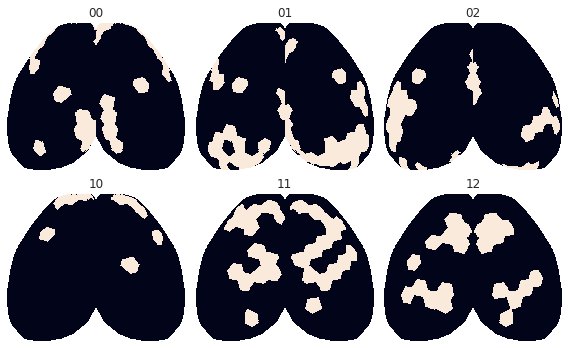

In [83]:
fig, axes = create_figure(2, 3, (8, 5))
for i, k in enumerate(coordinates):
    ax = axes.flat[i]
    x2p = mwh(tr['top'] == 0, tr['proj-top'][i])
    ax.imshow(x2p, cmap='rocket')
    ax.set_title(k)
remove_ticks(axes)

### Group pi

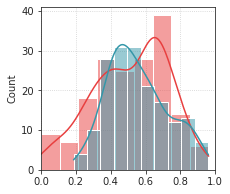

In [26]:
h_bold = sp_stats.entropy(gr_bold.grp_pi_prune) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.grp_pi_prune) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [27]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

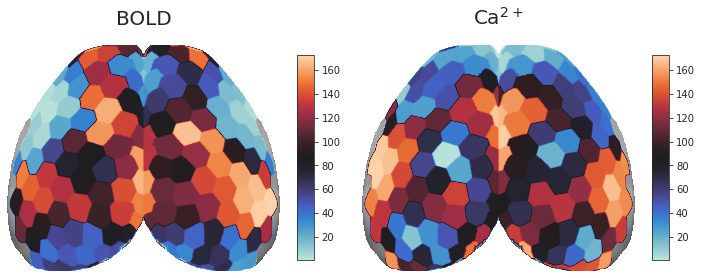

In [29]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

### Each run separately

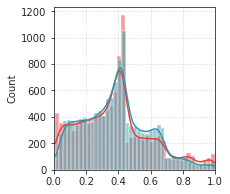

In [49]:
h_bold = sp_stats.entropy(gr_bold.run_pi_prune, axis=-2) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.run_pi_prune, axis=-2) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold[h_bold.nonzero()], color=pal['bold-lite'], kde=True)
sns.histplot(h_ca[h_ca.nonzero()], color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

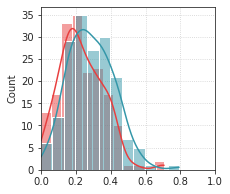

In [50]:
h_bold = bn.nanmean(bn.nanmean(bn.nanmean(h_bold, 2), 1), 0)
h_ca = bn.nanmean(bn.nanmean(bn.nanmean(h_ca, 2), 1), 0)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [51]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

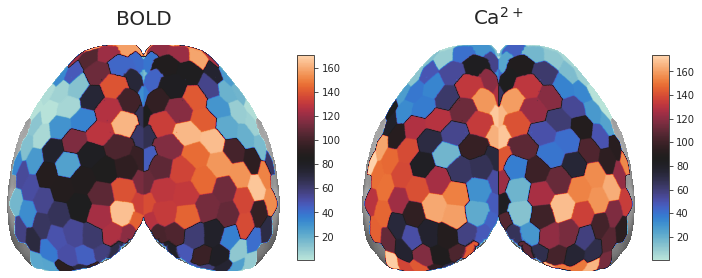

In [52]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

### Animals as units of variability

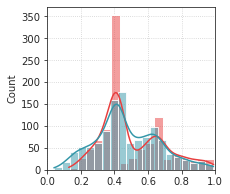

In [64]:
h_bold = sp_stats.entropy(gr_bold.anim_pi_prune, axis=-2) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.anim_pi_prune, axis=-2) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold[h_bold.nonzero()], color=pal['bold-lite'], kde=True)
sns.histplot(h_ca[h_ca.nonzero()], color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

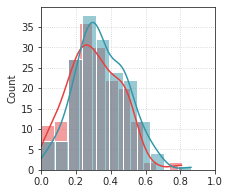

In [65]:
h_bold = bn.nanmean(h_bold, 0)
h_ca = bn.nanmean(h_ca, 0)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [66]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

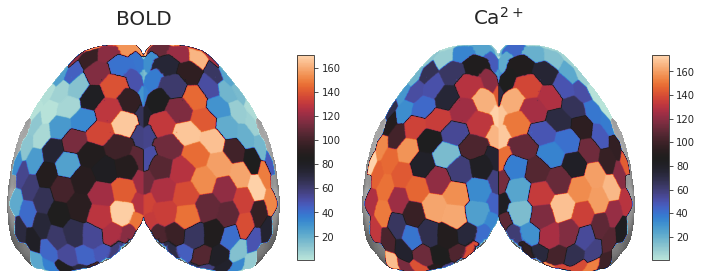

In [67]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

### Group pi (not pruned)

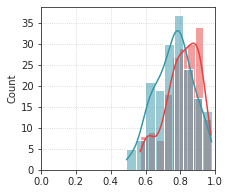

In [71]:
h_bold = sp_stats.entropy(gr_bold.grp_pi) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.grp_pi) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [72]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

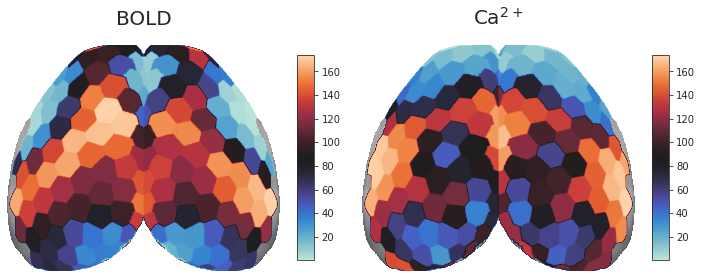

In [73]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

## Cartography

In [74]:
affil, affil_included = gr_bold.node_affiliations()

In [75]:
df_carto_ca = gr_ca.mk_cartography_df(affil=affil_included)
df_carto_bold = gr_bold.mk_cartography_df(affil=affil_included)
df_carto_bold = df_carto_bold.loc[~df_carto_bold['affil'].isin(['Auditory', 'Lateral'])]
df_carto_ca = df_carto_ca.loc[~df_carto_ca['affil'].isin(['Auditory', 'Lateral'])]

df_carto = pd.concat([df_carto_bold, df_carto_ca])

In [76]:
xlim = (-0.03, 0.7)
ylim = (2, 35)

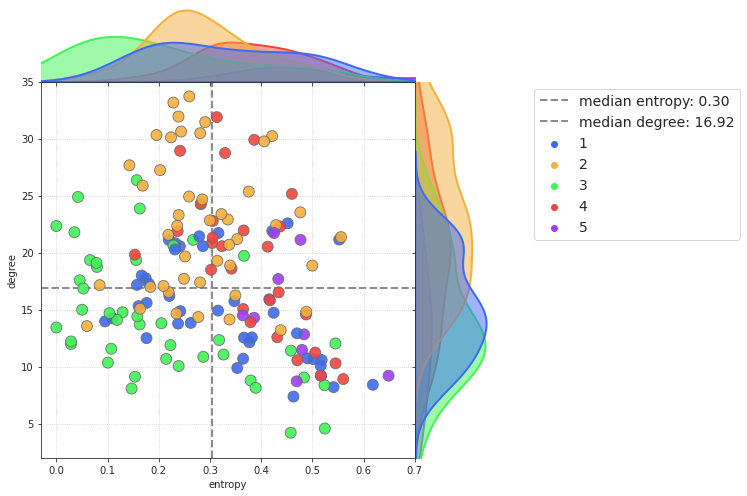

In [77]:
jg = plot_cartography(
    df=df_carto_bold,
    palette=gr_bold.colors,
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

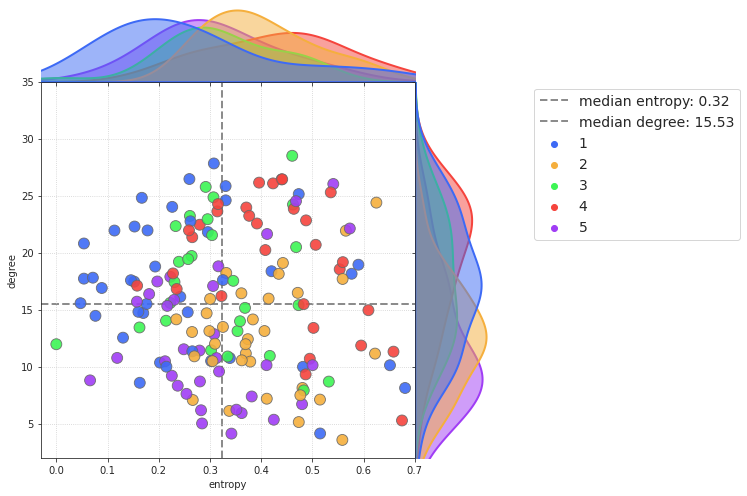

In [78]:
jg = plot_cartography(
    df=df_carto_ca,
    palette=gr_ca.colors,
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

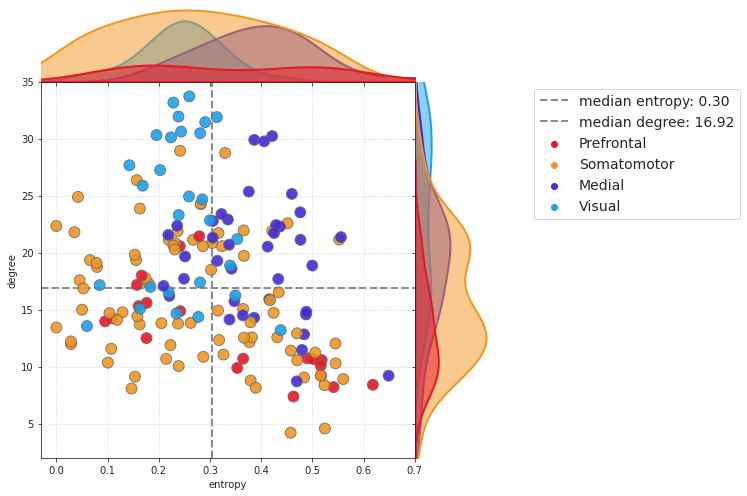

In [79]:
jg = plot_cartography(
    df=df_carto_bold,
    palette=affil['colors'],
    hue='affil',
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

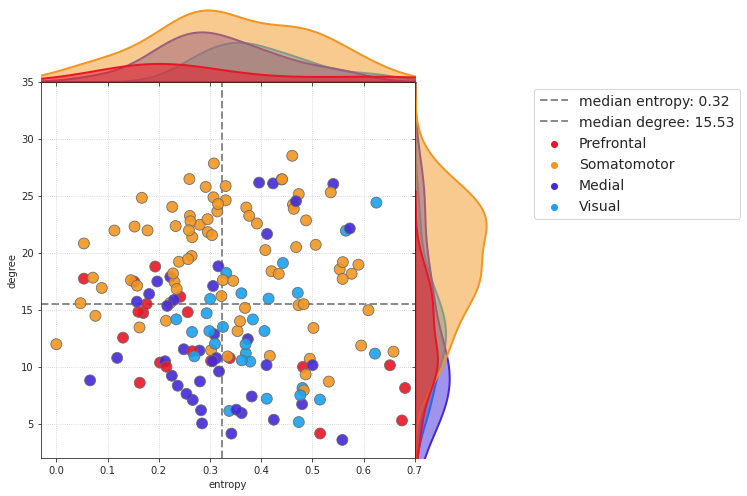

In [80]:

jg = plot_cartography(
    df=df_carto_ca,
    palette=affil['colors'],
    hue='affil',
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

### What about different h?

In [25]:
h_bold = sp_stats.entropy(gr_bold.grp_pi_prune) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.grp_pi_prune) / np.log(gr_ca.num_k)

### Weighted degrees

In [81]:
gr_bold.run_deg.shape

(10, 3, 4, 174)

In [84]:
dpb = gr_bold.project_vec(gr_bold.run_deg.reshape(-1, 174), add_disjoint=False)
dpc = gr_ca.project_vec(gr_ca.run_deg.reshape(-1, 174), add_disjoint=False)

In [85]:
trb = gr_bold.trim2d(dpb)
trc = gr_bold.trim2d(dpc)

In [86]:
list(trb)

['top', 'proj-top', 'flat', 'proj-flat']

In [87]:
trb['proj-top'].shape

(120, 857, 1034)

<AxesSubplot:ylabel='Count'>

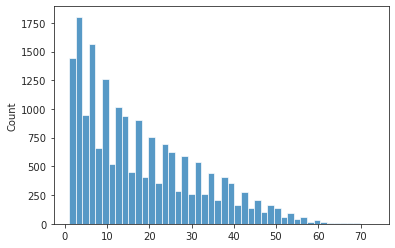

In [138]:
sns.histplot(gr_bold.run_deg[np.isfinite(gr_bold.run_deg)])

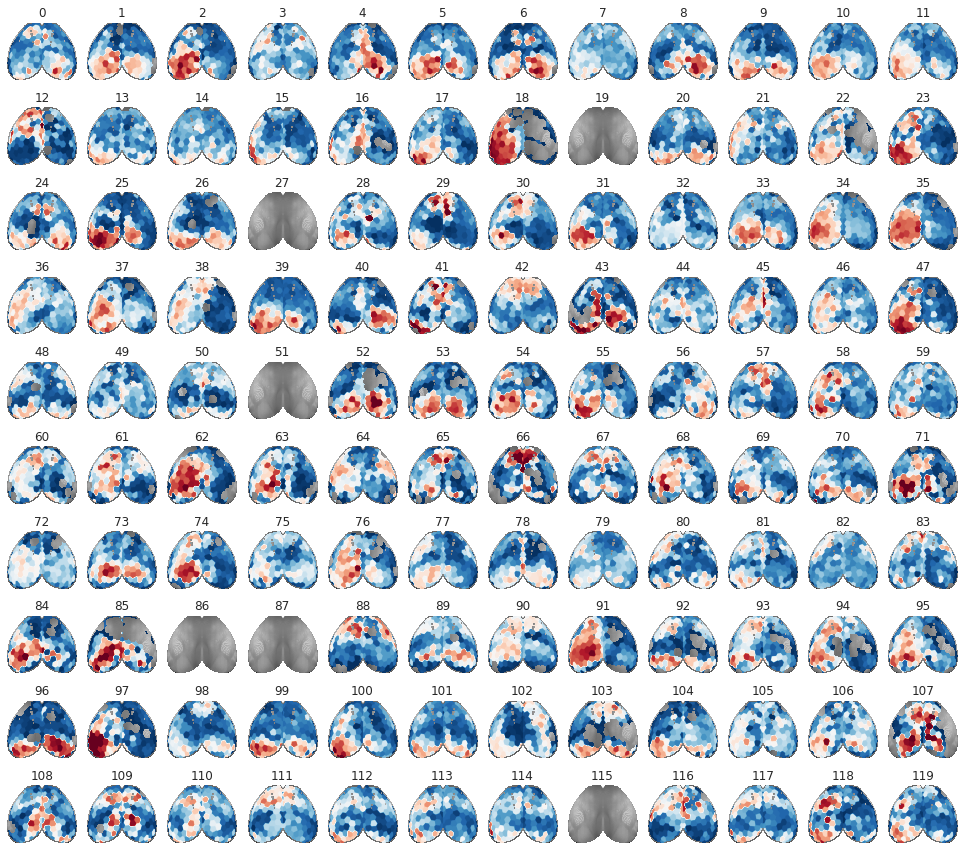

In [139]:
fig, axes = create_figure(10, 12, (13.5, 12))

for i, ax in enumerate(axes.flat):
    x2p = mwh(trb['top'] == 0, trb['top'])
    ax.imshow(x2p, cmap='Greys_r')
    x2p = mwh(trb['top'] == 0, trb['proj-top'][i])
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=1, vmax=60)
    ax.set_title(i)

remove_ticks(axes)

In [126]:
x = gr_bold.run_deg.reshape(-1, 174)[85]

In [127]:
x

memmap([14.,  2.,  2., 11., 23.,  3.,  5.,  3.,  2.,  3., 18.,  6.,  1.,
        nan, nan, nan, 25.,  1.,  7., nan, nan,  1., nan,  1., 20.,  1.,
        nan, nan,  1., 20., 18.,  1., 28., 37., nan,  1.,  2., 40., 19.,
        15., 10.,  3., 34., 42., 38., 24., 49., 12., 12., 59., 53., 55.,
        48., 37., 29., 56., 57., 42., 34., 65., 64., 18., 54., 54., 51.,
        54.,  9., 46., 46., 69., 39., 37., 50., 53., 51., 17., 45.,  3.,
        28., 25., 48., 18.,  6.,  1.,  1., 12., 12.,  3.,  2.,  1., 11.,
        nan,  2.,  2.,  1., nan,  1.,  9., nan, nan, nan, nan, nan, 35.,
        nan, nan,  2., nan,  1., nan, nan, 17.,  1., nan, nan, nan, nan,
        nan,  1., 15., 16., nan,  1., nan, nan, nan, nan,  8., nan, 15.,
        17., 20., nan, 37., nan, nan, 44., 36.,  2., 27.,  6.,  4., 54.,
        36., nan, 11., 29., 28.,  9.,  4., 45., 36., 24., 41., 42., 55.,
         5., 17.,  4., 34., 45., 16.,  6., 17.,  4., 38.,  6., 19., 16.,
        16.,  8.,  3.,  3.,  1.])

<AxesSubplot:ylabel='Count'>

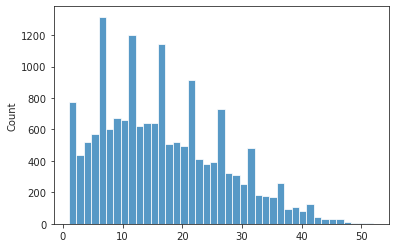

In [134]:
sns.histplot(gr_ca.run_deg[np.isfinite(gr_ca.run_deg)])

In [136]:
np.nanmin(gr_ca.run_deg), np.nanmax(gr_ca.run_deg)

(1.0, 52.0)

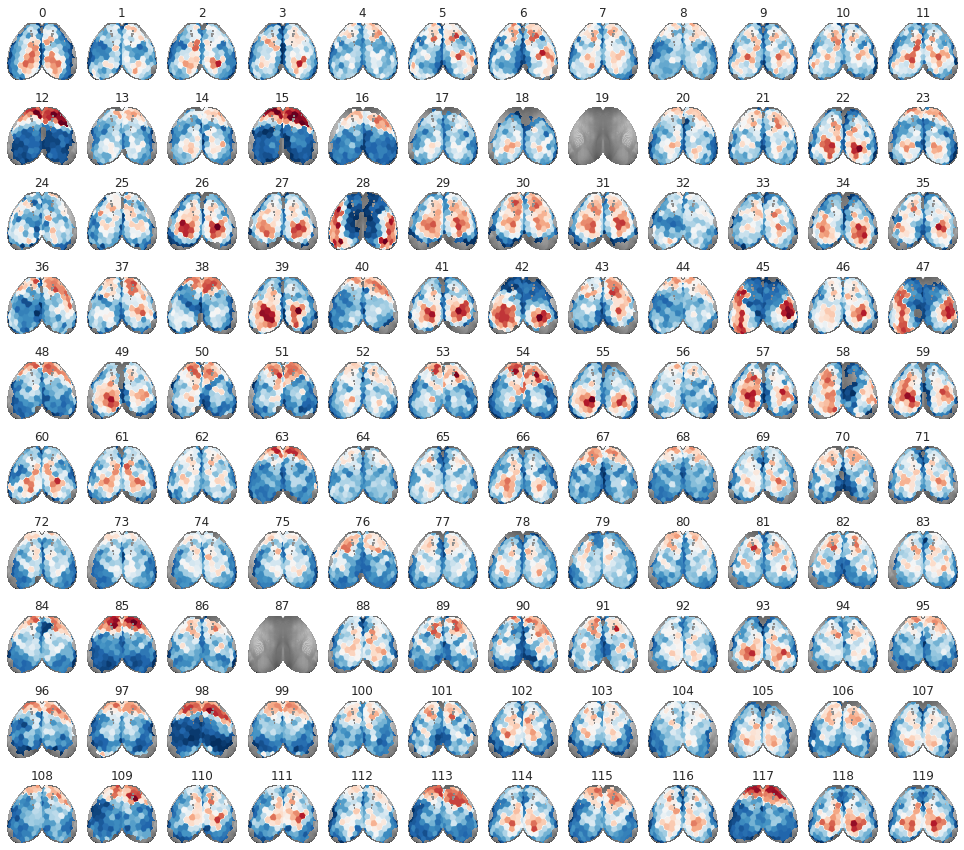

In [137]:
fig, axes = create_figure(10, 12, (13.5, 12))

for i, ax in enumerate(axes.flat):
    x2p = mwh(trc['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    x2p = mwh(trc['top'] == 0, trc['proj-top'][i])
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=1, vmax=50)
    ax.set_title(i)

remove_ticks(axes)

In [4]:
mice = Mice(256)
mice.setup_func_data('all')

In [5]:
pearson, spearman = {}, {}
for key, f in tqdm(mice.ca.items()):
    if f.task is None:
        continue
    x = f[:]
    nn = len(x)
    badt = np.isnan(x).sum(0) == nn
    good = np.isnan(x).sum(1) == badt.sum()
    mask = good.reshape(-1, 1) @ good.reshape(1, -1)
    x = x[good][:, ~badt]

    a = np_nans((nn,) * 2)
    a[mask] = get_adj_mat(x, 'pearson')[0].flat
    pearson[f"{key}_task-{f.task}"] = a
    
    a = np_nans((nn,) * 2)
    a[mask] = get_adj_mat(x, 'spearman')[0].flat
    spearman[f"{key}_task-{f.task}"] = a

  0%|          | 0/252 [00:00<?, ?it/s]

In [6]:
pearson_adj_ca, spearman_adj_ca = [], []
for k, pr in pearson.items():
    pearson_adj_ca.append(np.expand_dims(pr, axis=0))
    spearman_adj_ca.append(np.expand_dims(spearman[k], axis=0))
pearson_adj_ca = np.concatenate(pearson_adj_ca)
spearman_adj_ca = np.concatenate(spearman_adj_ca)
pearson_adj_ca[pearson_adj_ca < 0.] = 0.
spearman_adj_ca[spearman_adj_ca < 0.] = 0.

deg_pearson_ca = np.nansum(pearson_adj_ca, -1)
deg_spearman_ca = np.nansum(spearman_adj_ca, -1)

pearson_adj_ca.shape, spearman_adj_ca.shape

((252, 318, 318), (252, 318, 318))

In [7]:
led_run_ids = []
rest_run_ids = []
valid_run_ids = []
for i, k in enumerate(pearson):
    task = k.split('_')[-1].split('-')[-1]
    key = '_'.join(k.split('_')[:-1])
    *_, run = mice.looper[key]
    if run != -1:
        valid_run_ids.append(i)
        if task == 'led':
            led_run_ids.append(i)
        else:
            rest_run_ids.append(i)
led_run_ids = np.array(led_run_ids)
rest_run_ids = np.array(rest_run_ids)
valid_run_ids = np.array(valid_run_ids)

len(led_run_ids), len(rest_run_ids), len(valid_run_ids)

(90, 118, 208)

<AxesSubplot:ylabel='Count'>

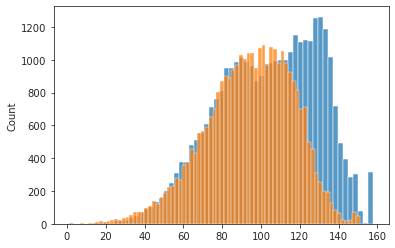

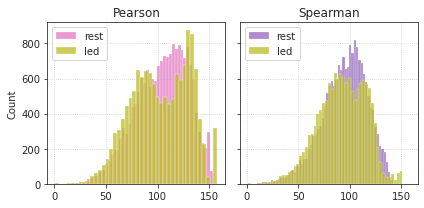

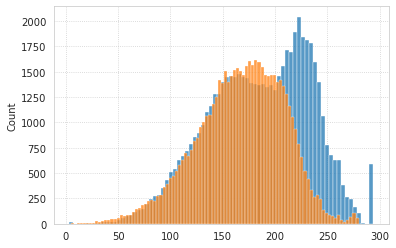

In [8]:
deg_pearson_ca = np.nansum(pearson_adj_ca, -1)
deg_spearman_ca = np.nansum(spearman_adj_ca, -1)

x = deg_pearson_ca[valid_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C0')
x = deg_spearman_ca[valid_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C1');

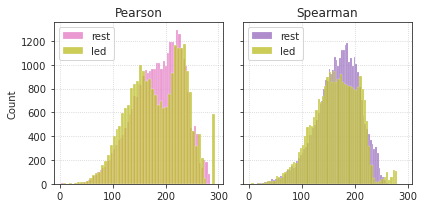

In [9]:
fig, axes = create_figure(1, 2, (6, 3), 'all', 'all')

x = deg_pearson_ca[rest_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C6', label='rest', ax=axes[0])
x = deg_pearson_ca[led_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C8', label='led', ax=axes[0])
axes[0].legend()
axes[0].set_title('Pearson')

x = deg_spearman_ca[rest_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C4', label='rest', ax=axes[1])
x = deg_spearman_ca[led_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C8', label='led', ax=axes[1])
axes[1].legend()
axes[1].set_title('Spearman')

add_grid(axes)

plt.show()

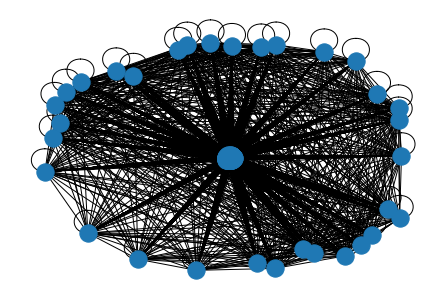

In [18]:
g = nx.from_numpy_array(pearson_adj_ca[3])
nx.draw(g)

<matplotlib.image.AxesImage object at 0x7fad2fc26a90>

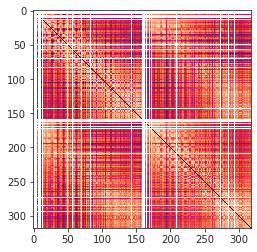

In [19]:
plt.imshow(nx.adjacency_matrix(g).toarray())

In [20]:
pearson_binary_ca = dc(pearson_adj_ca)
for i, a in enumerate(pearson_adj_ca):
    th = calculate_threshold(a, 0.1).item()
    pearson_binary_ca[i][pearson_binary_ca[i] <= th] = 0.
    pearson_binary_ca[i][pearson_binary_ca[i] > th] = 1

spearman_binary_ca = dc(spearman_adj_ca)
for i, a in enumerate(spearman_adj_ca):
    th = calculate_threshold(a, 0.1).item()
    spearman_binary_ca[i][spearman_binary_ca[i] <= th] = 0.
    spearman_binary_ca[i][spearman_binary_ca[i] > th] = 1

pearson_binary_ca.shape, spearman_binary_ca.shape

((252, 318, 318), (252, 318, 318))

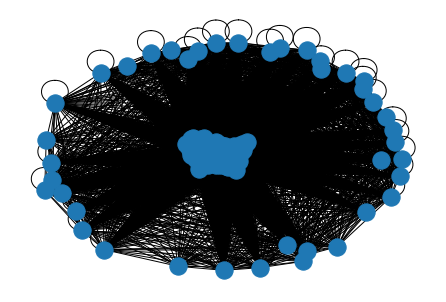

In [21]:
g = nx.from_numpy_array(pearson_binary_ca[3])
nx.draw(g)

<matplotlib.image.AxesImage object at 0x7fad04394a90>

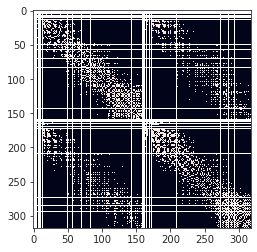

In [22]:
plt.imshow(nx.adjacency_matrix(g).toarray())

In [25]:
adj = nx.adjacency_matrix(g).toarray()
adj[np.isnan(adj)] = 0

In [26]:
adj.astype(bool).astype(int)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [15]:
mako = sns.color_palette('mako', as_cmap=True)
rocket = sns.color_palette('rocket', as_cmap=True)
pal = {'ca2': mako(0.6), 'bold-lite': rocket(0.6)}

num_k, perc = 5, 10
props_base = {
    'perc': f'p{perc}-sample',
    'num_k': num_k,
    'mice': mice,
    'task': 'rest',
    'metric': 'pearson',
    'match_using': 'gam',
    'match_metric': 'euclidean',
    'graph_type': 'real',
    'verbose': False,
}
props_ca = {'mode': 'ca2', **props_base}
props_bold = {'mode': 'bold-lite', **props_base}

gr_ca = Group(**props_ca)

In [16]:
deg_pearson_ca = np.nansum(pearson_binary_ca, -1)
deg_spearman_ca = np.nansum(spearman_binary_ca, -1)

deg_pearson_ca[deg_pearson_ca == 0] = np.nan
deg_spearman_ca[deg_spearman_ca == 0] = np.nan

In [17]:
proj_led_ca = gr_ca.project_vec(bn.nanmean(deg_spearman_ca[led_run_ids], 0), add_disjoint=False)
proj_rest_ca = gr_ca.project_vec(bn.nanmean(deg_spearman_ca[rest_run_ids], 0), add_disjoint=False)
trc_led = gr_ca.trim2d(proj_led_ca)
trc_rest = gr_ca.trim2d(proj_rest_ca)

<matplotlib.colorbar.Colorbar object at 0x7fa4c5345ee0>

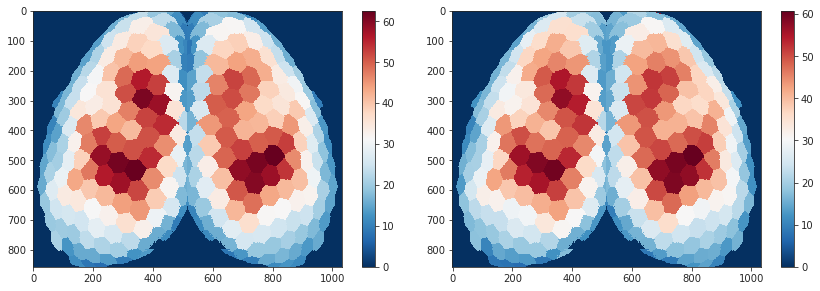

In [18]:
fig, axes = create_figure(1, 2, (12, 4))
im = axes[0].imshow(trc_rest['proj-top'][0], cmap='RdBu_r')
plt.colorbar(im, ax=axes[0])
im = axes[1].imshow(trc_led['proj-top'][0], cmap='RdBu_r')
plt.colorbar(im, ax=axes[1])

In [19]:
proj_led_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[led_run_ids], 0), add_disjoint=False)
proj_rest_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[rest_run_ids], 0), add_disjoint=False)
trc_led = gr_ca.trim2d(proj_led_ca)
trc_rest = gr_ca.trim2d(proj_rest_ca)

In [22]:
deg_spearman_ca = np.nansum(spearman_adj_ca, -1)
proj_led_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[led_run_ids], 0), add_disjoint=False)
proj_rest_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[rest_run_ids], 0), add_disjoint=False)
trc_led = gr_ca.trim2d(proj_led_ca)
trc_rest = gr_ca.trim2d(proj_rest_ca)

<matplotlib.colorbar.Colorbar object at 0x7fa4c5f189d0>

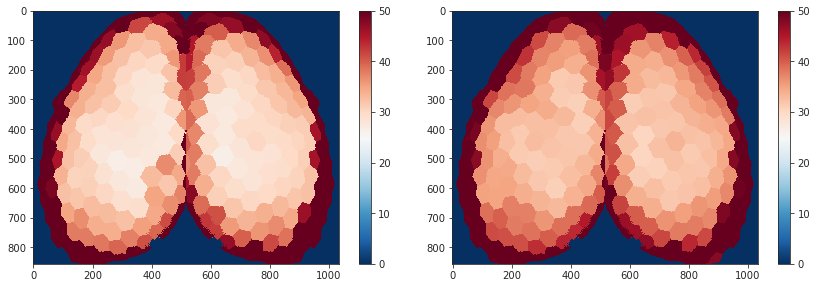

In [29]:
vamx = 50

fig, axes = create_figure(1, 2, (12, 4))
im = axes[0].imshow(trc_rest['proj-top'][0], cmap='RdBu_r', vmax=vamx)
plt.colorbar(im, ax=axes[0])
im = axes[1].imshow(trc_led['proj-top'][0], cmap='RdBu_r', vmax=vamx)
plt.colorbar(im, ax=axes[1])

<matplotlib.colorbar.Colorbar object at 0x7f5a937b6f70>

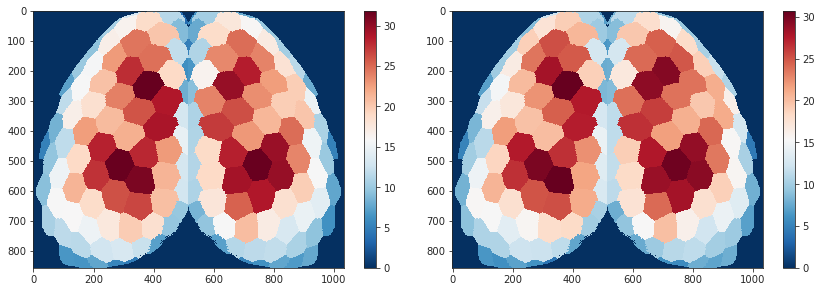

<matplotlib.colorbar.Colorbar object at 0x7f5931f84280>

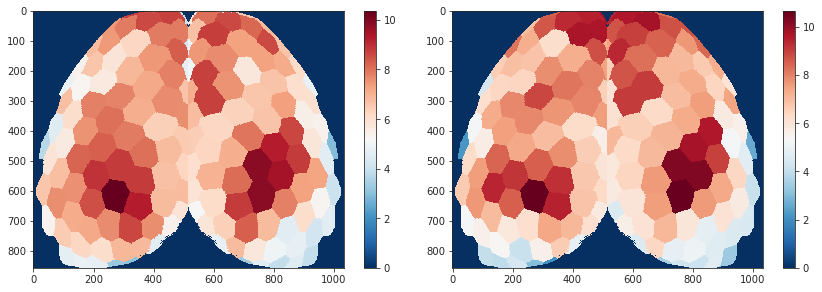

<matplotlib.colorbar.Colorbar object at 0x7f5aa64cb2e0>

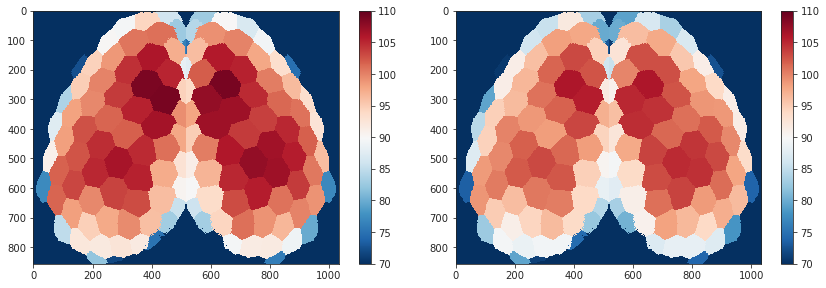

In [493]:
vmin = 70
vmax = 110

fig, axes = create_figure(1, 2, (12, 4))
im = axes[0].imshow(trc_rest['proj-top'][0], cmap='RdBu_r', vmin=vmin, vmax=vmax)
plt.colorbar(im, ax=axes[0])
im = axes[1].imshow(trc_led['proj-top'][0], cmap='RdBu_r', vmin=vmin, vmax=vmax)
plt.colorbar(im, ax=axes[1])

In [420]:
%%time

pearson_proj_ca = gr_ca.project_vec(deg_pearson_ca[valid_run_ids], add_disjoint=False)
spearman_proj_ca = gr_ca.project_vec(deg_spearman_ca[valid_run_ids], add_disjoint=False)

CPU times: user 15.4 s, sys: 5.88 s, total: 21.3 s
Wall time: 21.3 s


In [421]:
%%time

trc_pear = gr_ca.trim2d(pearson_proj_ca)
trc_spear = gr_ca.trim2d(spearman_proj_ca)

CPU times: user 12.1 s, sys: 37.5 s, total: 49.6 s
Wall time: 50.5 s


In [426]:
ncols = 13
nrows = int(np.ceil(len(trc_pear['proj-top']) / ncols))
nrows, ncols * nrows

(16, 208)

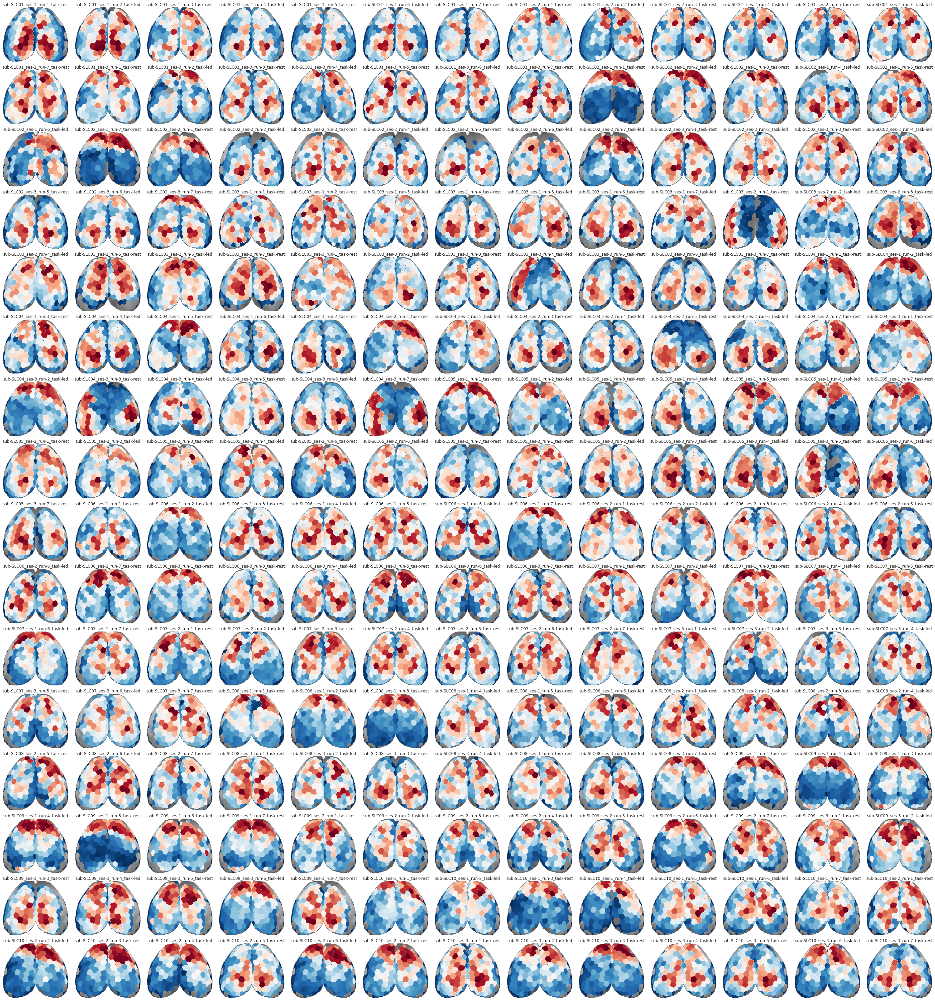

In [429]:
fig, axes = create_figure(nrows, ncols, (39, 2.6 * nrows))

for i, ax in enumerate(axes.flat):
    if i >= len(trc_pear['proj-top']):
        continue
    x2p = mwh(trc_pear['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    
    x2p = trc_pear['proj-top'][i].copy()
    vmin = np.nanmin(x2p[x2p.nonzero()])
    vmax = np.nanmax(x2p[x2p.nonzero()])
    x2p = gaussian_filter(x2p, 1)
    x2p = mwh(trc_pear['top'] == 0, x2p)
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=vmin, vmax=vmax)
    ax.set_title(list(pearson)[valid_run_ids[i]], fontsize=12)

remove_ticks(axes)
trim_axs(axes, len(trc_pear['proj-top']))
plt.show()

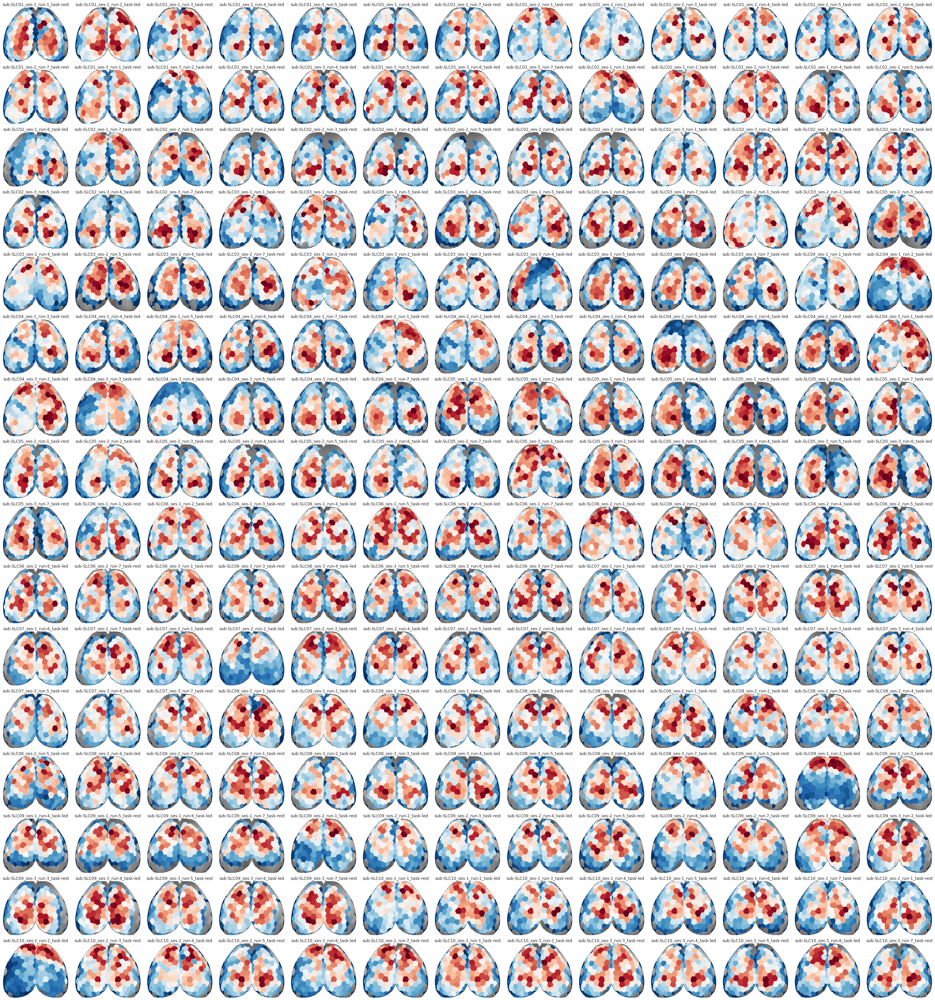

In [430]:
fig, axes = create_figure(nrows, ncols, (39, 2.6 * nrows))

for i, ax in enumerate(axes.flat):
    if i >= len(trc_spear['proj-top']):
        continue
    x2p = mwh(trc_spear['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    
    x2p = trc_spear['proj-top'][i].copy()
    vmin = np.nanmin(x2p[x2p.nonzero()])
    vmax = np.nanmax(x2p[x2p.nonzero()])
    x2p = gaussian_filter(x2p, 1)
    x2p = mwh(trc_spear['top'] == 0, x2p)
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=vmin, vmax=vmax)
    ax.set_title(list(spearman)[valid_run_ids[i]], fontsize=12)

remove_ticks(axes)
trim_axs(axes, len(trc_spear['proj-top']))
plt.show()

In [417]:
deg_spearman_ca[valid_run_ids]

(208, 174)

In [293]:
x = deg_pearson_ca[valid_run_ids][0].copy()

<AxesSubplot:ylabel='Count'>

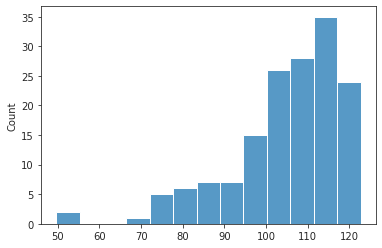

In [294]:
sns.histplot(x[x.nonzero()])

In [280]:
trc['proj-top']

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]])

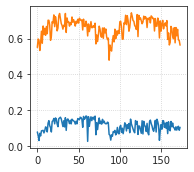

In [115]:
d_bold = res['a_bold'].mean(0)
d_ca = res['a_ca'].mean(0)

fig, ax = create_figure(figsize=(2.8, 2.5))
ax.plot(d_bold)
ax.plot(d_ca)
ax.grid()
plt.show()

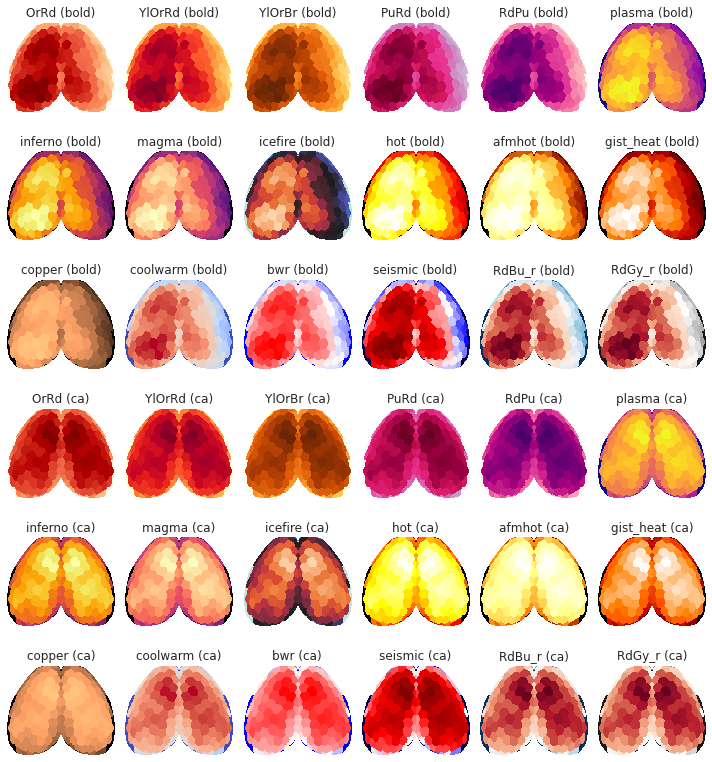

In [117]:
thres = -np.inf
dpb = gr_bold.project_vec(d_bold, thres=thres, add_disjoint=False)
dpc = gr_ca.project_vec(d_ca, thres=thres, add_disjoint=False)

trb = gr_bold.trim2d(dpb)
trc = gr_bold.trim2d(dpc)

fig, axes = create_figure(6, 6, (10, 11))

for cm, ax in zip(cm_candidates, axes[:3].flat):
    x2plt = np.ma.masked_where(trb['top'] == 0, trb['top'])
    ax.imshow(x2plt, cmap='Greys_r')
    x2plt = np.ma.masked_where(trb['top'] == 0, trb['proj-top'][0])
    ax.imshow(x2plt, cmap=cm, vmin=np.nanmin(d_bold), vmax=np.nanmax(d_bold))
    ax.set_title(f"{cm} (bold)")

for cm, ax in zip(cm_candidates, axes[3:].flat):
    x2plt = np.ma.masked_where(trc['top'] == 0, trc['top'])
    ax.imshow(x2plt, cmap='Greys_r')
    x2plt = np.ma.masked_where(trc['top'] == 0, trc['proj-top'][0])
    ax.imshow(x2plt, cmap=cm, vmin=np.nanmin(d_ca), vmax=np.nanmax(d_ca))
    ax.set_title(f"{cm} (ca)")
    
remove_ticks(axes)
plt.show()

## Voted out distribution

In [14]:
gr_ca.votes['votes'].shape

(174, 10, 5)

In [86]:
j, k = 3, 4
pi = gr_ca.run_pi
votes = gr_ca.votes['votes']
odd_ca = collections.defaultdict(list)
all_x_ca = []
for node in range(len(votes)):
    for anim in range(votes.shape[1]):
        v = votes[node, anim]
        v = v.reshape(1, 1, -1).astype(bool)
        v = np.repeat(v, j, axis=0)
        v = np.repeat(v, k, axis=1)
        x = pi[anim, ..., node][v]
        if len(x) and np.nanmax(x) > 0.9:
            odd_ca[mice.get_key(anim + 1)].append(node + 1)
        all_x_ca.extend(list(x))
odd_ca = dict(sorted(odd_ca.items()))
all_x_ca = np.array(all_x_ca)
all_x_ca = all_x_ca[np.isfinite(all_x_ca)]


pi = gr_bold.run_pi
votes = gr_bold.votes['votes']
odd_bold = collections.defaultdict(list)
all_x_bold = []
for node in range(len(votes)):
    for anim in range(votes.shape[1]):
        v = votes[node, anim]
        v = v.reshape(1, 1, -1).astype(bool)
        v = np.repeat(v, j, axis=0)
        v = np.repeat(v, k, axis=1)
        x = pi[anim, ..., node][v]
        if len(x) and np.nanmax(x) > 0.9:
            odd_bold[mice.get_key(anim + 1)].append(node + 1)
        all_x_bold.extend(list(x))
odd_bold = dict(sorted(odd_bold.items()))
all_x_bold = np.array(all_x_bold)
all_x_bold = all_x_bold[np.isfinite(all_x_bold)]

len(all_x_bold), len(all_x_ca)

(58536, 46982)

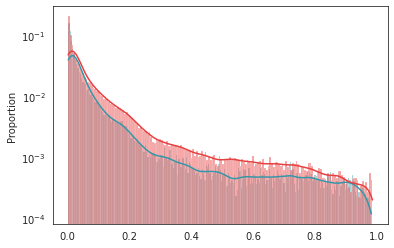

In [87]:
sns.histplot(all_x_ca, color=pal['ca2'], stat='proportion', kde=True)
sns.histplot(all_x_bold, color=pal['bold-lite'], stat='proportion', kde=True)
plt.yscale('log')

In [88]:
odd_ca

{
    'sub-SLC01': [
        5,
        9,
        10,
        12,
        65,
        84,
        85,
        87,
        94,
        96,
        97,
        99,
        100,
        102,
        103,
        105,
        106,
        109,
        111,
        113,
        172
    ],
    'sub-SLC03': [
        4,
        5,
        26,
        32,
        36,
        42,
        47,
        48,
        54,
        55,
        58,
        61,
        63,
        64,
        65,
        70,
        73,
        83,
        96,
        98,
        119,
        126,
        129,
        134,
        143,
        146,
        149,
        151,
        154,
        157,
        160,
        163,
        165,
        167,
        168,
        170,
        172
    ],
    'sub-SLC04': [
        2,
        4,
        16,
        17,
        32,
        40,
        42,
        46,
        48,
        49,
        53,
        54,
        55,
        58,
        61,
        63,
        67,
        68,
        69,
        74,
        78,
        79,
        81,
        88,
        89,
        90,
        91,
        92,
        93,
        94,
        96,
        97,
        100,
        111,
        119,
        154,
        161,
        163,
        164,
        166
    ],
    'sub-SLC05': [31, 39, 40, 42, 46, 48, 53, 54, 67, 77, 119, 120, 144, 153],
    'sub-SLC06': [9, 18, 22, 26, 100, 105, 109, 113],
    'sub-SLC07': [
        12,
        15,
        16,
        19,
        24,
        44,
        45,
        52,
        96,
        97,
        106,
        109,
        111,
        113,
        131,
        137
    ],
    'sub-SLC08': [3, 9, 13, 18, 22, 31, 73, 78, 85, 105],
    'sub-SLC09': [
        22,
        24,
        56,
        59,
        64,
        66,
        73,
        74,
        76,
        78,
        79,
        85,
        117,
        133,
        142,
        143,
        146,
        149,
        151,
        154,
        157,
        159,
        160,
        165,
        173
    ],
    'sub-SLC10': [
        3,
        5,
        10,
        64,
        73,
        74,
        78,
        97,
        99,
        100,
        103,
        106,
        109,
        113,
        116,
        160,
        163,
        165
    ]
}

In [89]:
xxx_ca = gr_ca.votes['votes'].sum(-1) == 5
xxx_bold = gr_bold.votes['votes'].sum(-1) == 5

xxx_ca.shape, xxx_bold.shape

((174, 10), (174, 10))

In [90]:
xxx_ca[4], xxx_bold[4]

(
    array([False, False,  True, False, False, False, False, False, False,
       False]),
    array([False, False, False, False, False, False, False,  True, False,
       False])
)

In [91]:
xxx_ca.sum(1)

array([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 2, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 0, 1, 2, 0, 0, 0, 0, 0, 4, 0, 0, 1,
       0, 1, 2, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 2, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 3, 0, 1, 2, 1, 0, 2, 0, 3, 1, 1, 1, 0, 1, 0, 1, 0, 0])

In [92]:
xxx_bold.sum(1)

array([0, 1, 0, 0, 1, 1, 2, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 3, 2, 0, 0, 0, 0,
       0, 1, 1, 0, 2, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 2, 0, 1,
       0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 2, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 2, 2, 1, 0, 0,
       0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [94]:
xxx_ca.sum(), xxx_bold.sum()

(61, 54)

In [96]:
np.argmax(xxx_ca.sum(1)) + 1

85

In [98]:
xxx_ca[84]

array([ True, False, False,  True, False, False, False,  True,  True,
       False])

## Entropy

In [99]:
gr_ca_pruned_h = Group(**props_ca).load_group(use_pruned_for_h=True)
gr_bold_pruned_h = Group(**props_bold).load_group(use_pruned_for_h=True)

gr_ca_full_h = Group(**props_ca).load_group(use_pruned_for_h=False)
gr_bold_full_h = Group(**props_bold).load_group(use_pruned_for_h=False)

grp_h_new_ca = sp_stats.entropy(gr_ca.grp_pi_prune, axis=-2) / np.log(gr_ca.num_k)
grp_h_new_bold = sp_stats.entropy(gr_bold.grp_pi_prune, axis=-2) / np.log(gr_bold.num_k)

run_h_avg_ca = bn.nanmean(bn.nanmean(bn.nanmean(gr_ca_pruned_h.run_h, 2), 1), 0)
run_h_avg_bold = bn.nanmean(bn.nanmean(bn.nanmean(gr_bold_pruned_h.run_h, 2), 1), 0)

pruned:

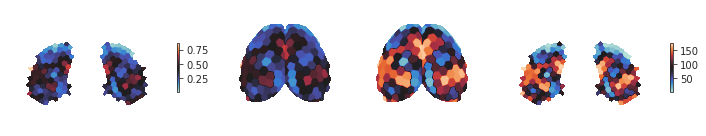

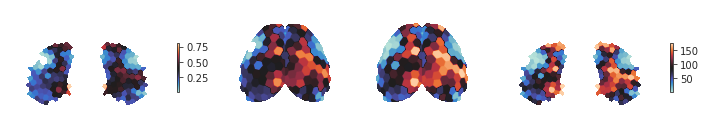

pruned, but new:

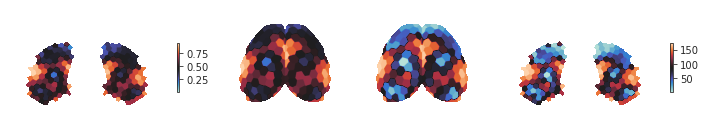

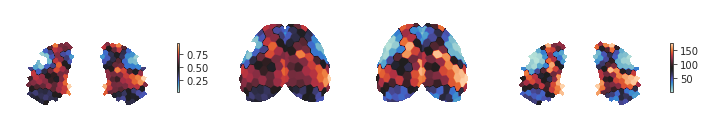

pruned, but run avg:

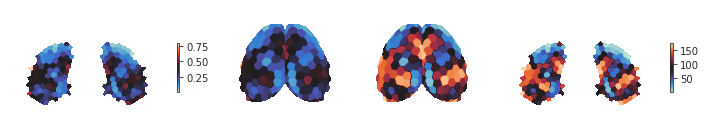

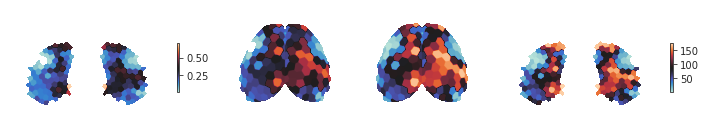

full:

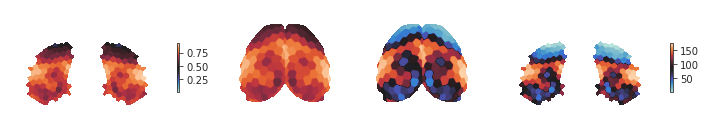

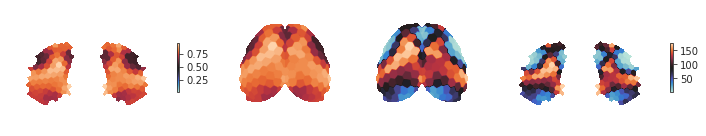

In [100]:
print('pruned:')
show_h(
    gr_ca_pruned_h.project_vec(gr_ca_pruned_h.grp_h, add_disjoint=False),
    gr_ca_pruned_h.project_vec(gr_ca_pruned_h.grp_hr, add_disjoint=False),
)
show_h(
    gr_bold_pruned_h.project_vec(gr_bold_pruned_h.grp_h, add_disjoint=False),
    gr_bold_pruned_h.project_vec(gr_bold_pruned_h.grp_hr, add_disjoint=False),
)

print('\npruned, but new:')
show_h(
    gr_ca.project_vec(grp_h_new_ca, add_disjoint=False),
    gr_ca.project_vec(sp_stats.rankdata(grp_h_new_ca), add_disjoint=False),
)
show_h(
    gr_bold.project_vec(grp_h_new_bold, add_disjoint=False),
    gr_bold.project_vec(sp_stats.rankdata(grp_h_new_bold), add_disjoint=False),
)

print('\npruned, but run avg:')
show_h(
    gr_ca.project_vec(run_h_avg_ca, add_disjoint=False),
    gr_ca.project_vec(sp_stats.rankdata(run_h_avg_ca), add_disjoint=False),
)
show_h(
    gr_bold.project_vec(run_h_avg_bold, add_disjoint=False),
    gr_bold.project_vec(sp_stats.rankdata(run_h_avg_bold), add_disjoint=False),
)

print('\n full:')
show_h(
    gr_ca_full_h.project_vec(gr_ca_full_h.grp_h, add_disjoint=False),
    gr_ca_full_h.project_vec(gr_ca_full_h.grp_hr, add_disjoint=False),
)
show_h(
    gr_bold_full_h.project_vec(gr_bold_full_h.grp_h, add_disjoint=False),
    gr_bold_full_h.project_vec(gr_bold_full_h.grp_hr, add_disjoint=False),
)

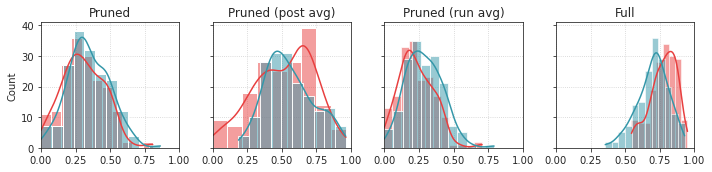

In [101]:
fig, axes = create_figure(1, 4, (10, 2.5), 'all', 'all')

sns.histplot(gr_bold_pruned_h.grp_h, kde=True, color=pal['bold-lite'], ax=axes[0])
sns.histplot(gr_ca_pruned_h.grp_h, kde=True, color=pal['ca2'], ax=axes[0])

sns.histplot(grp_h_new_bold, kde=True, color=pal['bold-lite'], ax=axes[1])
sns.histplot(grp_h_new_ca, kde=True, color=pal['ca2'], ax=axes[1])

sns.histplot(run_h_avg_bold, kde=True, color=pal['bold-lite'], ax=axes[2])
sns.histplot(run_h_avg_ca, kde=True, color=pal['ca2'], ax=axes[2])

sns.histplot(gr_bold_full_h.grp_h, kde=True, color=pal['bold-lite'], ax=axes[3])
sns.histplot(gr_ca_full_h.grp_h, kde=True, color=pal['ca2'], ax=axes[3])

axes[0].set_title('Pruned')
axes[1].set_title('Pruned (post avg)')
axes[2].set_title('Pruned (run avg)')
axes[3].set_title('Full')
axes[0].set_xlim(0, 1)
add_grid(axes)
plt.show()

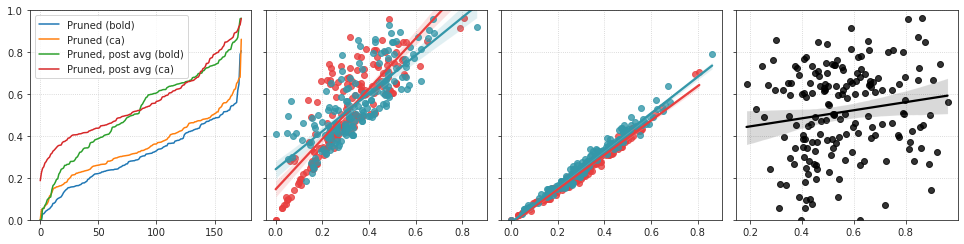

In [62]:
fig, axes = create_figure(1, 4, figsize=(13.5, 3.5), sharey='all')
axes[0].plot(sorted(gr_bold.grp_h), label='Pruned (bold)')
axes[0].plot(sorted(gr_ca.grp_h), label='Pruned (ca)')
axes[0].plot(sorted(grp_h_new_bold), label='Pruned, post avg (bold)')
axes[0].plot(sorted(grp_h_new_ca), label='Pruned, post avg (ca)')
axes[0].legend()
axes[0].set_ylim(0, 1)

sns.regplot(x=gr_bold.grp_h, y=grp_h_new_bold, color=pal['bold-lite'], ax=axes[1])
sns.regplot(x=gr_ca.grp_h, y=grp_h_new_ca, color=pal['ca2'], ax=axes[1])

sns.regplot(x=gr_bold.grp_h, y=run_h_avg_bold, color=pal['bold-lite'], ax=axes[2])
sns.regplot(x=gr_ca.grp_h, y=run_h_avg_ca, color=pal['ca2'], ax=axes[2])

sns.regplot(x=grp_h_new_ca, y=grp_h_new_bold, color='k', ax=axes[3])
# sns.regplot(x=grp_h_new_bold, y=grp_h_new_ca, color=pal['ca2'], ax=axes[3])
# sns.regplot(x=gr_ca.grp_h, y=gr_bold.grp_h, color='k', ax=axes[3])

add_grid(axes)

plt.show()

[<matplotlib.lines.Line2D object at 0x7f29caa58bb0>]

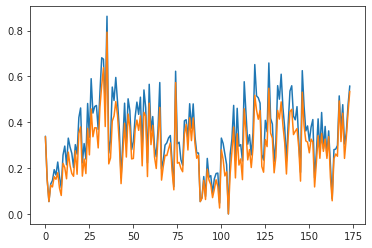

In [64]:
plt.plot(gr_ca.grp_h)
plt.plot(run_h_avg_ca)

## TODO: make a pairplot (add the bold, ca stuff there and tag pruned vs post avg vs full)

[<matplotlib.lines.Line2D object at 0x7f17a709fac0>]

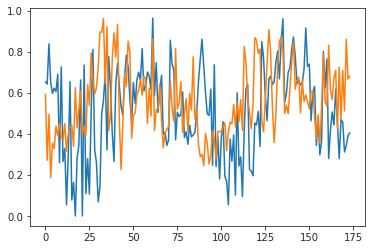

In [104]:
plt.plot(grp_h_new_bold)
plt.plot(grp_h_new_ca)

## Stacked bar plot

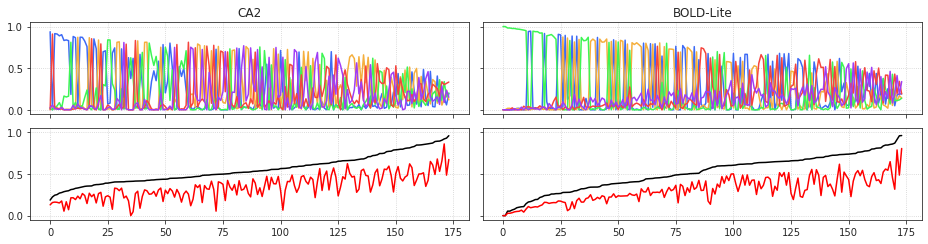

In [106]:
fig, axes = create_figure(2, 2, (13, 3.5), 'all', 'all')

sort = np.argsort(grp_h_new_ca)
for i in range(gr_ca.num_k):
    axes[0, 0].plot(gr_ca.grp_pi_prune[i][sort], color=gr_ca.colors[i + 1])
axes[1, 0].plot(grp_h_new_ca[sort], color='k')
axes[1, 0].plot(gr_ca.grp_h[sort], color='r')
axes[0, 0].set_title('CA2')

sort = np.argsort(grp_h_new_bold)
for i in range(gr_bold.num_k):
    axes[0, 1].plot(gr_bold.grp_pi_prune[i][sort], color=gr_bold.colors[i + 1])
axes[1, 1].plot(grp_h_new_bold[sort], color='k')
axes[1, 1].plot(gr_bold.grp_h[sort], color='r')
axes[0, 1].set_title('BOLD-Lite')

add_grid(axes)
plt.show()

In [115]:
grp_h_new_ca = sp_stats.entropy(gr_ca.grp_pi_prune, axis=-2) / np.log(gr_ca.num_k)
grp_h_new_bold = sp_stats.entropy(gr_bold.grp_pi_prune, axis=-2) / np.log(gr_bold.num_k)
grp_h_both = (grp_h_new_ca + grp_h_new_bold) / 2

sort_ca = np.argsort(grp_h_new_ca)
sort_bold = np.argsort(grp_h_new_bold)
sort_both = np.argsort(grp_h_both)

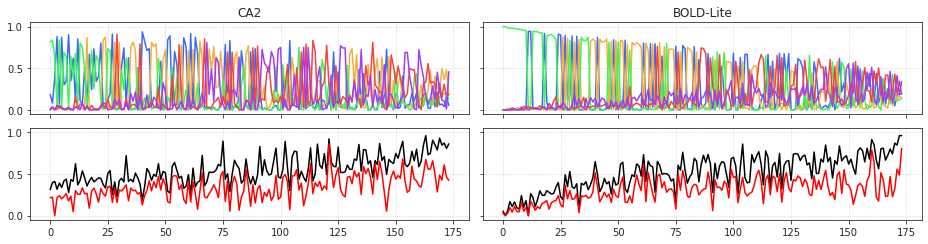

In [116]:
fig, axes = create_figure(2, 2, (13, 3.5), 'all', 'all')

for i in range(gr_ca.num_k):
    axes[0, 0].plot(gr_ca.grp_pi_prune[i][sort_both], color=gr_ca.colors[i + 1])
axes[1, 0].plot(grp_h_new_ca[sort_both], color='k')
axes[1, 0].plot(gr_ca.grp_h[sort_both], color='r')
axes[0, 0].set_title('CA2')

sort = np.argsort(grp_h_new_bold)
for i in range(gr_bold.num_k):
    axes[0, 1].plot(gr_bold.grp_pi_prune[i][sort], color=gr_bold.colors[i + 1])
axes[1, 1].plot(grp_h_new_bold[sort_both], color='k')
axes[1, 1].plot(gr_bold.grp_h[sort_both], color='r')
axes[0, 1].set_title('BOLD-Lite')

add_grid(axes)
plt.show()

In [117]:
sort_both[0]

12

In [119]:
gr_ca.grp_pi_prune[:, sort_both[0]], gr_bold.grp_pi_prune[:, sort_both[0]]

(
    memmap([0.18449166, 0.        , 0.81137915, 0.        , 0.0041292 ]),
    memmap([0.        , 0.01719355, 0.98280645, 0.        , 0.        ])
)

In [126]:
gr_ca.grp_pi_prune[0, labels]

array([0.18449166, 0.07980469, 0.375     , 0.88084286, 0.06917142,
       0.87215254, 0.29785313, 0.34537845, 0.90222057, 0.34904448])

In [125]:
gr_ca.grp_pi_prune[:, labels].shape

(5, 10)

In [138]:
sort_both.shape

(174,)

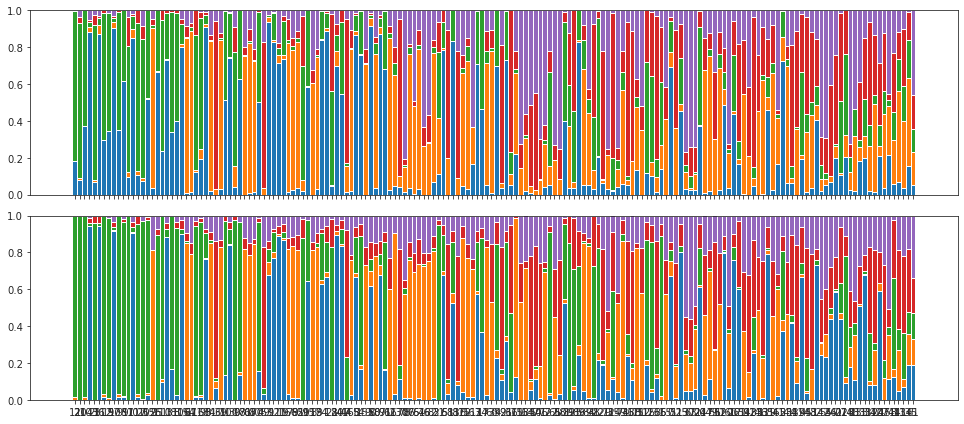

In [139]:
# nodes = np.array([sort_both[i] for i in range(100)])
nodes = sort_both
# men_means = [20, 35, 30, 35, 27]
# women_means = [25, 32, 34, 20, 25]
# men_std = [2, 3, 4, 1, 2]
# women_std = [3, 5, 2, 3, 3]
width = 1      # the width of the bars: can also be len(x) sequence

fig, axes = create_figure(2, 1, (13.5, 6), 'all', 'all')

bottom_ca = np.zeros(len(nodes))
bottom_bold = np.zeros(len(nodes))
for k in range(5):
    height = gr_ca.grp_pi_prune[k, nodes]
    axes[0].bar(
        x=[str(i) for i in nodes],
        height=height,
        width=width,
        bottom=bottom_ca,
        label=f'OC_{k}',
    )
    bottom_ca += height
    
    height = gr_bold.grp_pi_prune[k, nodes]
    axes[1].bar(
        x=[str(i) for i in nodes],
        height=height,
        width=width,
        bottom=bottom_bold,
        label=f'OC_{k}',
    )
    bottom_bold += height

plt.show()

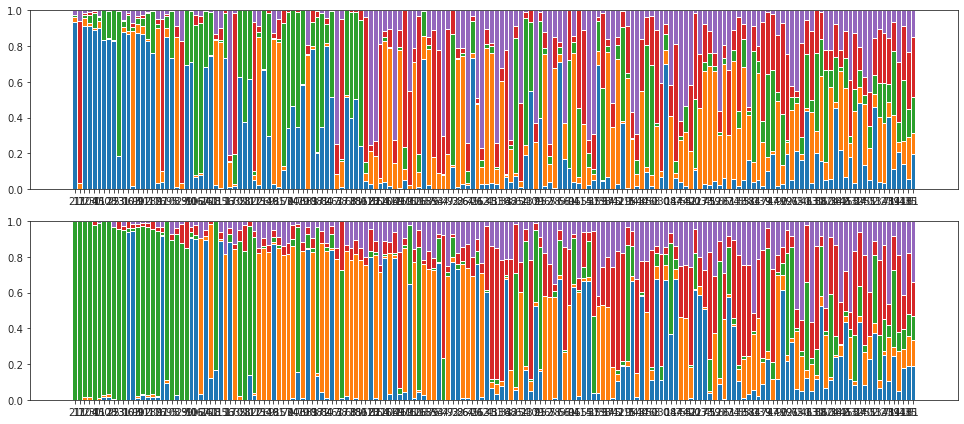

In [141]:
# nodes = np.array([sort_both[i] for i in range(100)])
nodes = sort_both
# men_means = [20, 35, 30, 35, 27]
# women_means = [25, 32, 34, 20, 25]
# men_std = [2, 3, 4, 1, 2]
# women_std = [3, 5, 2, 3, 3]
width = 1      # the width of the bars: can also be len(x) sequence

fig, axes = create_figure(2, 1, (13.5, 6))

bottom_ca = np.zeros(len(sort_ca))
bottom_bold = np.zeros(len(sort_bold))
for k in range(5):
    height = gr_ca.grp_pi_prune[k, sort_ca]
    axes[0].bar(
        x=[str(i) for i in sort_bold],
        height=height,
        width=width,
        bottom=bottom_ca,
        label=f'OC_{k}',
    )
    bottom_ca += height
    
    height = gr_bold.grp_pi_prune[k, sort_bold]
    axes[1].bar(
        x=[str(i) for i in sort_bold],
        height=height,
        width=width,
        bottom=bottom_bold,
        label=f'OC_{k}',
    )
    bottom_bold += height

plt.show()

In [150]:
x = gr_bold.grp_pi_prune.copy()
x[x < 0.2] = 0
x /= np.nansum(x, axis=0)

y = gr_ca.grp_pi_prune.copy()
y[y < 0.2] = 0
y /= np.nansum(y, axis=0)

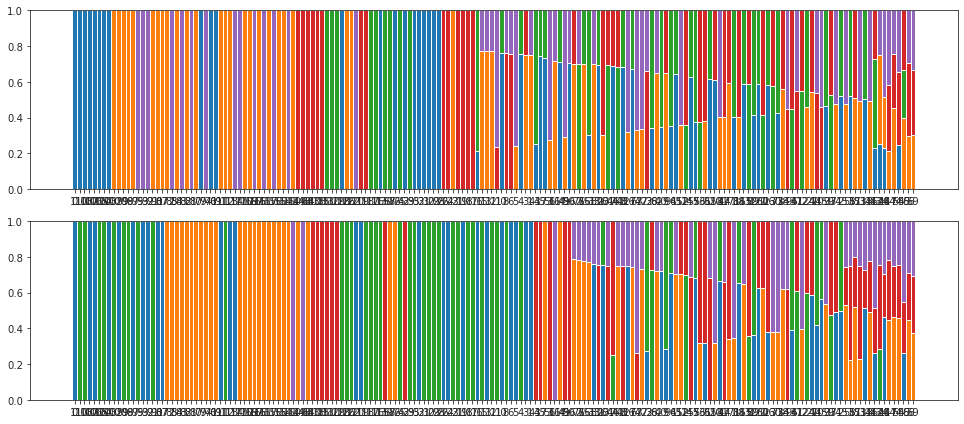

In [152]:
fig, axes = create_figure(2, 1, (13.5, 6))

sort_ca = np.argsort(sp_stats.entropy(y, axis=0))
sort_bold = np.argsort(sp_stats.entropy(x, axis=0))

bottom_ca = np.zeros(len(sort_ca))
bottom_bold = np.zeros(len(sort_bold))
for k in range(5):
    height = y[k, sort_ca]
    axes[0].bar(
        x=[str(i) for i in sort_bold],
        height=height,
        width=width,
        bottom=bottom_ca,
        label=f'OC_{k}',
    )
    bottom_ca += height
    
    height = x[k, sort_bold]
    axes[1].bar(
        x=[str(i) for i in sort_bold],
        height=height,
        width=width,
        bottom=bottom_bold,
        label=f'OC_{k}',
    )
    bottom_bold += height

plt.show()

In [153]:
sort_bold[-20:]

array([109, 159,  37,  34,   2, 153,  58,  57,  53, 133, 146, 142, 134,
        46, 147, 144,  54,  55,  66,  59])

In [154]:
sort_ca[-20:]

array([137,  14,  35, 171, 102,  84,  11,  48,  75, 105,  65, 128, 161,
       158, 143, 146, 127,  39,  41,  56])